In [1]:
import matplotlib.pyplot as plt
import arviz as az
import pandas as pd
import numpy as np

import tensorflow as tf
import tensorflow_probability as tfp

tfd = tfp.distributions
tfb = tfp.bijectors
root = tfd.JointDistributionCoroutine.Root

import datetime
print(f"Last Run {datetime.datetime.now()}")

Last Run 2021-10-18 16:11:43.539122


In [2]:
az.style.use("arviz-grayscale")
plt.rcParams["figure.dpi"] = 300

In [3]:
co2_by_month = pd.read_csv("../data/monthly_mauna_loa_co2.csv")
co2_by_month["date_month"] = pd.to_datetime(co2_by_month["date_month"])
co2_by_month["CO2"] = co2_by_month["CO2"].astype(np.float32)
co2_by_month.set_index("date_month", drop=True, inplace=True)

num_forecast_steps = 12 * 10  # Forecast the final ten years, given previous data
co2_by_month_training_data = co2_by_month[:-num_forecast_steps]
co2_by_month_testing_data = co2_by_month[-num_forecast_steps:]

/var/folders/7p/srk5qjp563l5f9mrjtp44bh800jqsw/T/ipykernel_72521/1698526664.py:19: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.autofmt_xdate()


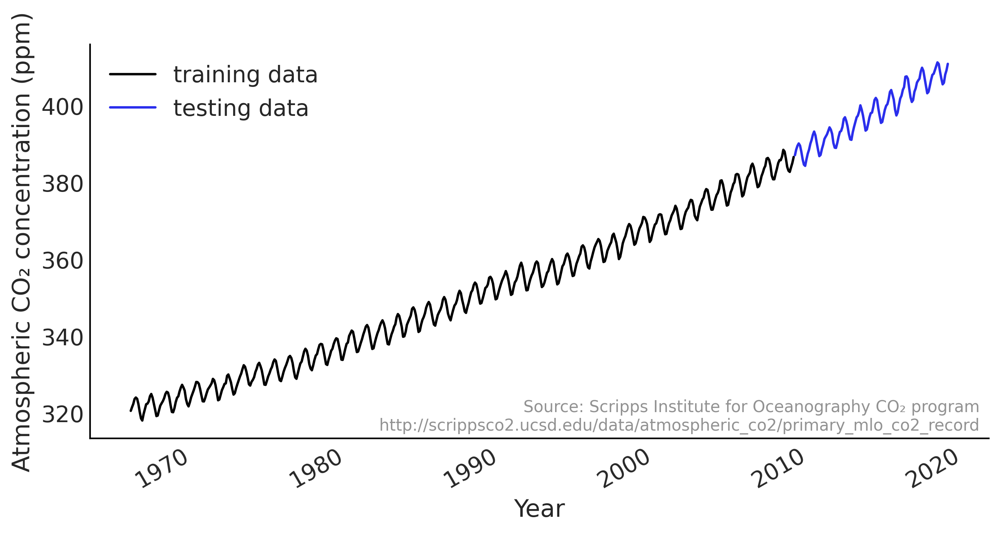

In [4]:
def plot_co2_data(fig_ax=None):
    if not fig_ax:
        fig, ax = plt.subplots(1, 1, figsize=(10, 5))
    else:
        fig, ax = fig_ax
    ax.plot(co2_by_month_training_data, label="training data")
    ax.plot(co2_by_month_testing_data, color="C4", label="testing data")
    ax.legend()
    ax.set(
        ylabel="Atmospheric CO₂ concentration (ppm)",
        xlabel="Year"
    )
    ax.text(0.99, .02,
            """Source: Scripps Institute for Oceanography CO₂ program
            http://scrippsco2.ucsd.edu/data/atmospheric_co2/primary_mlo_co2_record""",
            transform=ax.transAxes,
            horizontalalignment="right",
            alpha=0.5)
    fig.autofmt_xdate()
    return fig, ax


_ = plot_co2_data()
plt.savefig("img/chp06/fig1_co2_by_month.png")

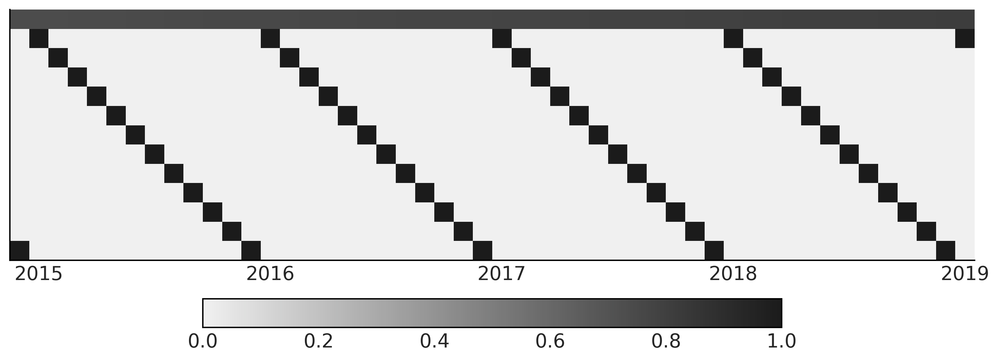

In [5]:
trend_all = np.linspace(0., 1., len(co2_by_month))[..., None]
trend_all = trend_all.astype(np.float32)
trend = trend_all[:-num_forecast_steps, :]

seasonality_all = pd.get_dummies(
   co2_by_month.index.month).values.astype(np.float32)
seasonality = seasonality_all[:-num_forecast_steps, :]

fig, ax = plt.subplots(figsize=(10, 4))
X_subset = np.concatenate([trend, seasonality], axis=-1)[-50:]
im = ax.imshow(X_subset.T, cmap="cet_gray_r")

label_loc = np.arange(1, 50, 12)
ax.set_xticks(label_loc)
ax.set_yticks([])
ax.set_xticklabels(co2_by_month.index.year[-50:][label_loc])
fig.colorbar(im, ax=ax, orientation="horizontal", shrink=.6)

plt.savefig("img/chp06/fig2_sparse_design_matrix.png")

In [6]:
root = tfd.JointDistributionCoroutine.Root

@tfd.JointDistributionCoroutine
def ts_regression_model():
    intercept = yield root(tfd.Normal(0., 100., name='intercept'))
    trend_coeff = yield root(tfd.Normal(0., 10., name='trend_coeff'))
    seasonality_coeff = yield root(
        tfd.Sample(tfd.Normal(0., 1.),
                   sample_shape=seasonality.shape[-1],
                   name='seasonality_coeff'))
    noise = yield root(tfd.HalfCauchy(loc=0., scale=5., name='noise_sigma'))
    y_hat = (intercept[..., None] +
             tf.einsum('ij,...->...i', trend, trend_coeff) +
             tf.einsum('ij,...j->...i', seasonality, seasonality_coeff))
    observed = yield tfd.Independent(
        tfd.Normal(y_hat, noise[..., None]),
        reinterpreted_batch_ndims=1,
        name='observed')

# If we remove the decorator @tfd.JointDistributionCoroutine above:
# ts_regression_model = tfd.JointDistributionCoroutine(ts_regression_model)

# check shape
ts_regression_model.log_prob_parts(ts_regression_model.sample(4))

2021-10-18 16:11:46.338079: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


StructTuple(
  intercept=<tf.Tensor: shape=(4,), dtype=float32, numpy=array([-5.78191  , -5.6509676, -5.5728803, -5.5390143], dtype=float32)>,
  trend_coeff=<tf.Tensor: shape=(4,), dtype=float32, numpy=array([-3.6069634, -5.078785 , -3.2258735, -4.18004  ], dtype=float32)>,
  seasonality_coeff=<tf.Tensor: shape=(4,), dtype=float32, numpy=array([-12.389635, -17.159496, -18.782154, -16.775375], dtype=float32)>,
  noise_sigma=<tf.Tensor: shape=(4,), dtype=float32, numpy=array([-2.8225455, -4.2936153, -2.0696228, -3.866254 ], dtype=float32)>,
  observed=<tf.Tensor: shape=(4,), dtype=float32, numpy=array([-1601.4634 , -2092.6724 ,  -327.36694, -1989.7524 ], dtype=float32)>
)

/var/folders/7p/srk5qjp563l5f9mrjtp44bh800jqsw/T/ipykernel_72521/2060325595.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.autofmt_xdate()


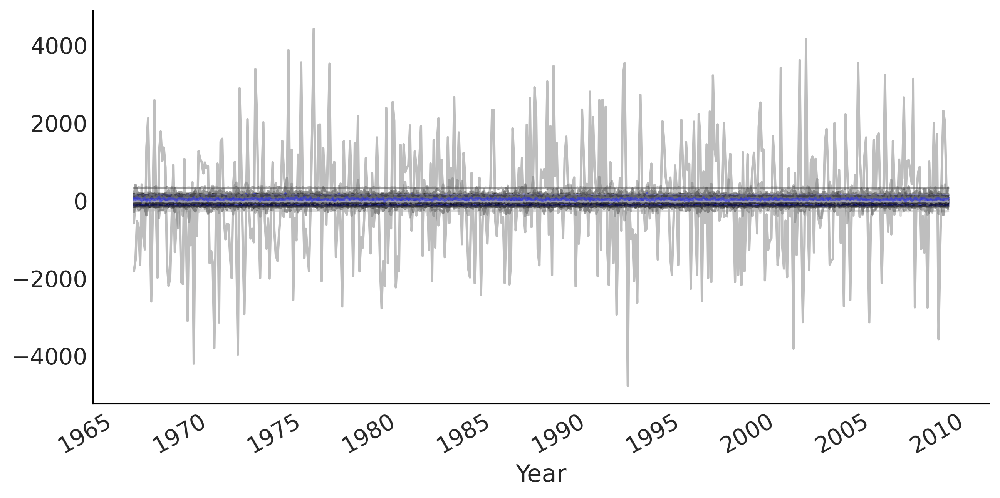

In [7]:
# draw 100 prior and prior predictive samples
prior_samples = ts_regression_model.sample(100)  
prior_predictive_timeseries = prior_samples[-1]

fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(co2_by_month.index[:-num_forecast_steps],
        tf.transpose(prior_predictive_timeseries), alpha=.5)
ax.set_xlabel("Year")
fig.autofmt_xdate()

plt.savefig("img/chp06/fig3_prior_predictive1.png")

In [8]:
run_mcmc = tf.function(
    tfp.experimental.mcmc.windowed_adaptive_nuts,
    autograph=False, jit_compile=True)

In [9]:
%%time
mcmc_samples, sampler_stats = run_mcmc(
    1000, ts_regression_model, n_chains=4, num_adaptation_steps=1000,
    observed=co2_by_month_training_data["CO2"].values[None, ...])

Instructions for updating:
`scale_identity_multiplier` is deprecated; please combine it into `scale_diag` directly instead.


2021-10-18 16:11:57.801665: I tensorflow/compiler/xla/service/service.cc:171] XLA service 0x7fc9cac09a90 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2021-10-18 16:11:57.801870: I tensorflow/compiler/xla/service/service.cc:179]   StreamExecutor device (0): Host, Default Version
2021-10-18 16:11:58.311136: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:210] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2021-10-18 16:11:58.479915: W tensorflow/compiler/tf2xla/kernels/random_ops.cc:96] Warning: Using tf.random.uniform with XLA compilation will ignore seeds; consider using tf.random.stateless_uniform instead if reproducible behavior is desired. sanitize_seed/seed
2021-10-18 16:11:58.714611: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator mcmc_retry_init/assert_equal_1/Assert/AssertGuard/Assert
2021-10-18 16:12:15.695876: I tensorflow/compiler/jit/xla_compilat

CPU times: user 27.4 s, sys: 1.03 s, total: 28.5 s
Wall time: 28.9 s


In [10]:
regression_idata = az.from_dict(
    posterior={
        k:np.swapaxes(v.numpy(), 1, 0)
        for k, v in mcmc_samples._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]}
)

az.summary(regression_idata)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
intercept,317.428,0.324,316.838,318.066,0.013,0.009,604.0,823.0,1.0
trend_coeff,80.650,0.297,80.112,81.240,0.005,0.003,3866.0,2767.0,1.0
seasonality_coeff[0],0.083,0.369,-0.608,0.770,0.013,0.009,787.0,1607.0,1.0
seasonality_coeff[1],0.636,0.369,-0.038,1.348,0.013,0.009,817.0,1521.0,1.0
seasonality_coeff[2],1.302,0.369,0.628,2.001,0.013,0.010,761.0,1274.0,1.0
seasonality_coeff[3],2.434,0.368,1.726,3.116,0.013,0.009,847.0,1718.0,1.0
seasonality_coeff[4],2.846,0.368,2.131,3.506,0.013,0.009,778.0,1606.0,1.0
seasonality_coeff[5],2.207,0.372,1.496,2.897,0.014,0.010,753.0,1624.0,1.0
seasonality_coeff[6],0.703,0.372,-0.054,1.355,0.014,0.010,699.0,1194.0,1.0
seasonality_coeff[7],-1.305,0.372,-1.965,-0.575,0.013,0.009,795.0,1760.0,1.0


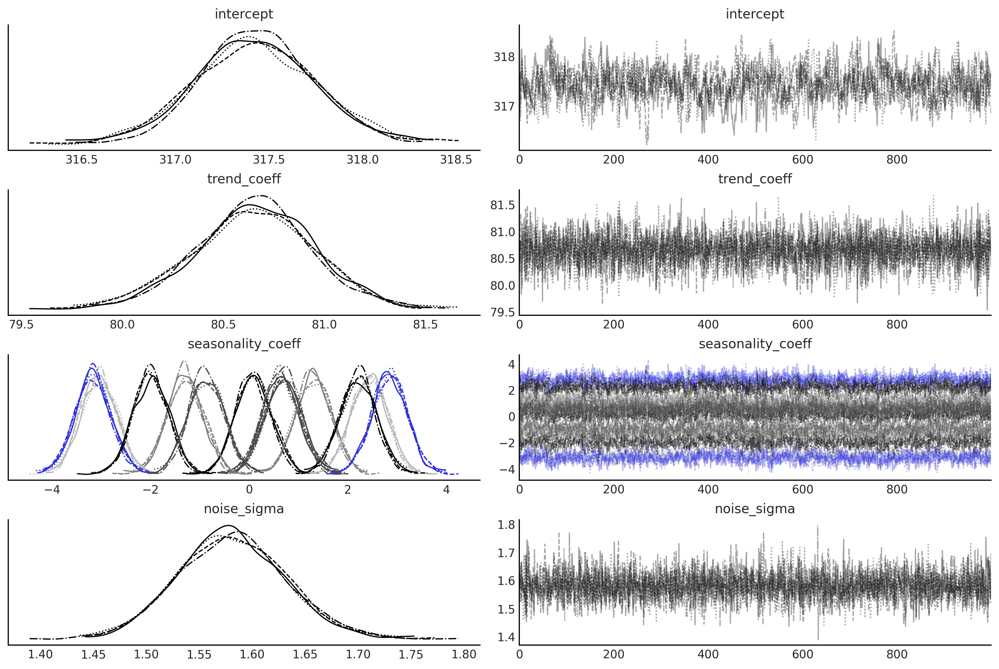

In [11]:
axes = az.plot_trace(regression_idata, compact=True);

In [12]:
# We can draw posterior predictive sample with jd.sample_distributions()
posterior_dist, posterior_and_predictive = ts_regression_model.sample_distributions(
    value=mcmc_samples)
posterior_predictive_samples = posterior_and_predictive[-1]
posterior_predictive_dist = posterior_dist[-1]

# Since we want to also plot the posterior predictive distribution for 
# each components, conditioned on both training and testing data, we
# construct the posterior predictive distribution as below:
nchains = regression_idata.posterior.dims['chain']

trend_posterior = mcmc_samples.intercept + \
    tf.einsum('ij,...->i...', trend_all, mcmc_samples.trend_coeff)
seasonality_posterior = tf.einsum(
    'ij,...j->i...', seasonality_all, mcmc_samples.seasonality_coeff)

y_hat = trend_posterior + seasonality_posterior
posterior_predictive_dist = tfd.Normal(y_hat, mcmc_samples.noise_sigma)
posterior_predictive_samples = posterior_predictive_dist.sample()

/var/folders/7p/srk5qjp563l5f9mrjtp44bh800jqsw/T/ipykernel_72521/865649276.py:13: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.autofmt_xdate()


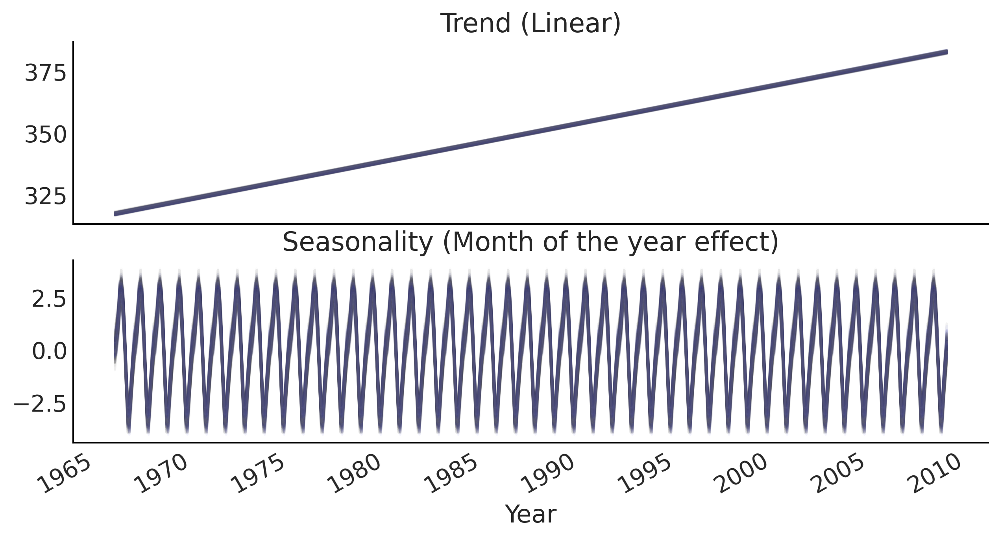

In [13]:
# plot components
fig, ax = plt.subplots(2, 1, figsize=(10, 5), sharex=True)

for i in range(nchains):
    ax[0].plot(co2_by_month.index[:-num_forecast_steps],
               trend_posterior[:-num_forecast_steps, -100:, i], alpha=.05)
    ax[1].plot(co2_by_month.index[:-num_forecast_steps],
               seasonality_posterior[:-num_forecast_steps, -100:, i], alpha=.05)

ax[0].set_title('Trend (Linear)')
ax[1].set_title('Seasonality (Month of the year effect)')
ax[1].set_xlabel("Year")
fig.autofmt_xdate()

plt.savefig("img/chp06/fig4_posterior_predictive_components1.png")

/var/folders/7p/srk5qjp563l5f9mrjtp44bh800jqsw/T/ipykernel_72521/1698526664.py:19: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.autofmt_xdate()


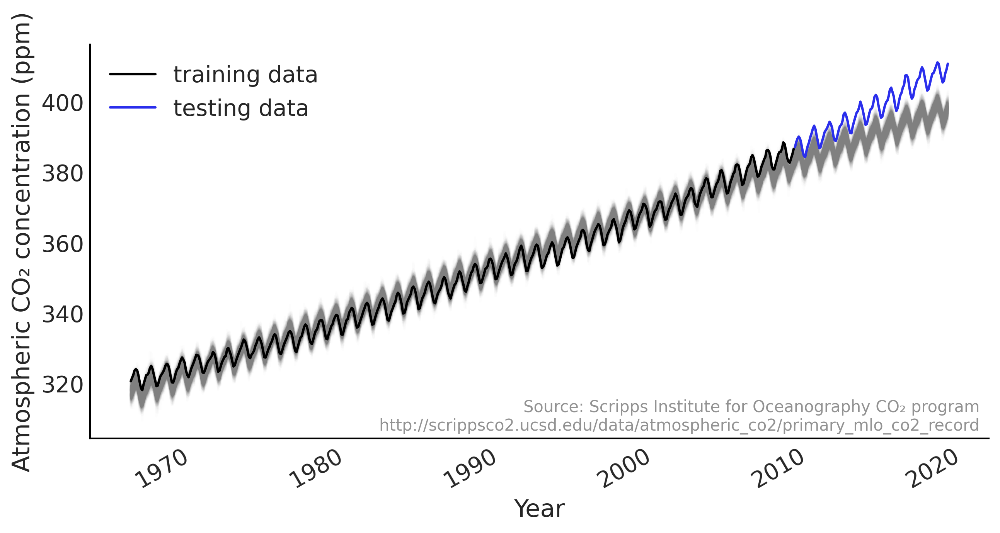

In [14]:
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
sample_shape = posterior_predictive_samples.shape[1:]
ax.plot(co2_by_month.index,
        tf.reshape(posterior_predictive_samples,
                   [-1, tf.math.reduce_prod(sample_shape)])[:, :500],
        color='gray', alpha=.01)

plot_co2_data((fig, ax))
plt.savefig("img/chp06/fig5_posterior_predictive1.png")

# GAM


In [15]:
n_changepoints = 8
n_tp = 500
t = np.linspace(0, 1, n_tp)
s = np.linspace(0, 1, n_changepoints + 2)[1:-1]
A = (t[:, None] > s)

k, m = 2.5, 40
delta = np.random.laplace(.1, size=n_changepoints)
growth = (k + A @ delta) * t
offset = m + A @ (-s * delta)
trend = growth + offset

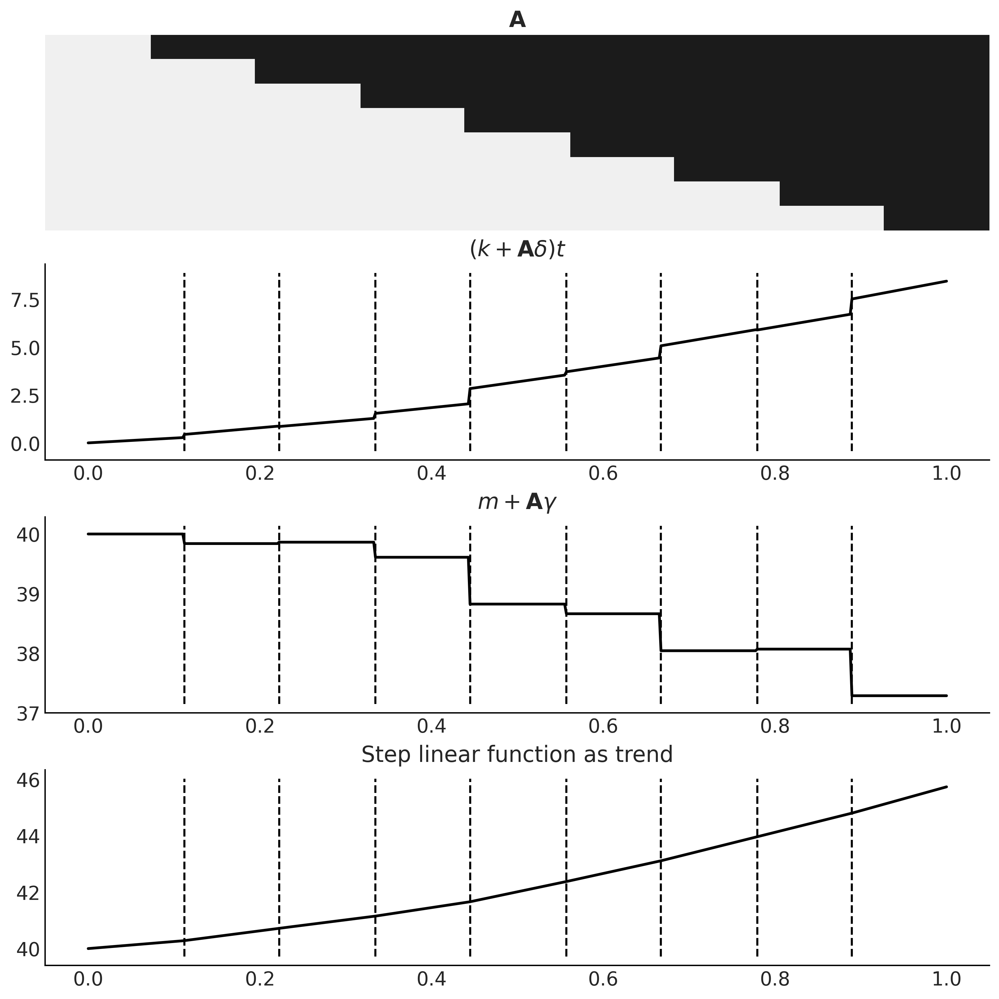

In [16]:
_, ax = plt.subplots(4, 1, figsize=(10, 10))
ax[0].imshow(A.T, cmap="cet_gray_r", aspect='auto', interpolation='none');
ax[0].axis('off')
ax[0].set_title(r'$\mathbf{A}$')
ax[1].plot(t, growth, lw=2)
ax[1].set_title(r'$(k + \mathbf{A}\delta) t$')
ax[2].plot(t, offset, lw=2)
ax[2].set_title(r'$m + \mathbf{A} \gamma$')
ax[3].plot(t, trend, lw=2);
ax[3].set_title('Step linear function as trend');

lines = [np.where(t > s_)[0][0] for s_ in s]
for ax_ in ax[1:]:
    ax_.vlines(t[lines], *ax_.get_ylim(), linestyles='--');
    
plt.savefig("img/chp06/fig6_step_linear_function.png");

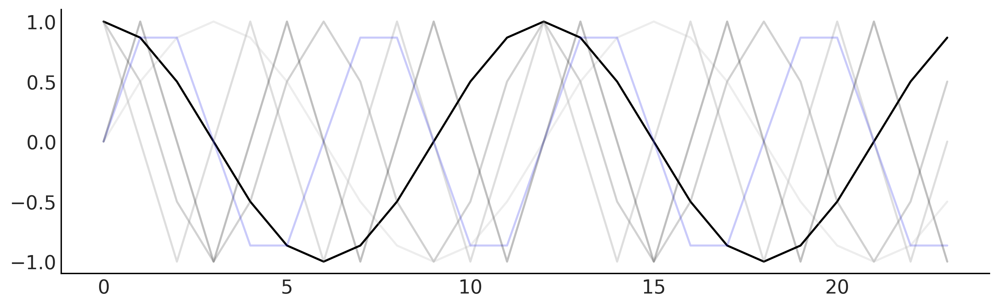

In [17]:
def gen_fourier_basis(t, p=365.25, n=3):
    x = 2 * np.pi * (np.arange(n) + 1) * t[:, None] / p
    return np.concatenate((np.cos(x), np.sin(x)), axis=1)

n_tp = 500
p = 12
t_monthly = np.asarray([i % p for i in range(n_tp)])
monthly_X = gen_fourier_basis(t_monthly, p=p, n=3)

fig, ax = plt.subplots(figsize=(10, 3))
ax.plot(monthly_X[:p*2, 0])
ax.plot(monthly_X[:p*2, 1:], alpha=.25)

plt.savefig("img/chp06/fig7_fourier_basis.png")

In [18]:
n_changepoints = 12

n_tp = seasonality_all.shape[0]
t = np.linspace(0, 1, n_tp, dtype=np.float32)
s = np.linspace(0, max(t), n_changepoints + 2, dtype=np.float32)[1: -1]
A = (t[:, None] > s).astype(np.float32)

# Set n=6 here so that there are 12 columns, which is the same as `seasonality_all`
X_pred = gen_fourier_basis(np.where(seasonality_all)[1],
                           p=seasonality_all.shape[-1],
                           n=6)
n_pred = X_pred.shape[-1]


def gen_gam_jd(training=True):
    @tfd.JointDistributionCoroutine
    def gam():
        beta = yield root(tfd.Sample(
            tfd.Normal(0., 1.),
            sample_shape=n_pred,
            name='beta'))
        seasonality = tf.einsum('ij,...j->...i', X_pred, beta)

        k = yield root(tfd.HalfNormal(10., name='k'))
        m = yield root(tfd.Normal(
            co2_by_month_training_data['CO2'].mean(), scale=5., name='m'))
        tau = yield root(tfd.HalfNormal(10., name='tau'))
        delta = yield tfd.Sample(tfd.Laplace(0., tau),
                                 sample_shape=n_changepoints,
                                 name='delta')

        growth_rate = k[..., None] + tf.einsum('ij,...j->...i', A, delta)
        offset = m[..., None] + tf.einsum('ij,...j->...i', A, -s * delta)
        trend = growth_rate * t + offset

        y_hat = seasonality + trend
        if training:
            y_hat = y_hat[..., :co2_by_month_training_data.shape[0]]

        noise_sigma = yield root(tfd.HalfNormal(scale=5., name='noise_sigma'))
        observed = yield tfd.Independent(
            tfd.Normal(y_hat, noise_sigma[..., None]),
            reinterpreted_batch_ndims=1,
            name='observed'
        )

    return gam


gam = gen_gam_jd()

/var/folders/7p/srk5qjp563l5f9mrjtp44bh800jqsw/T/ipykernel_72521/970221687.py:8: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.autofmt_xdate()


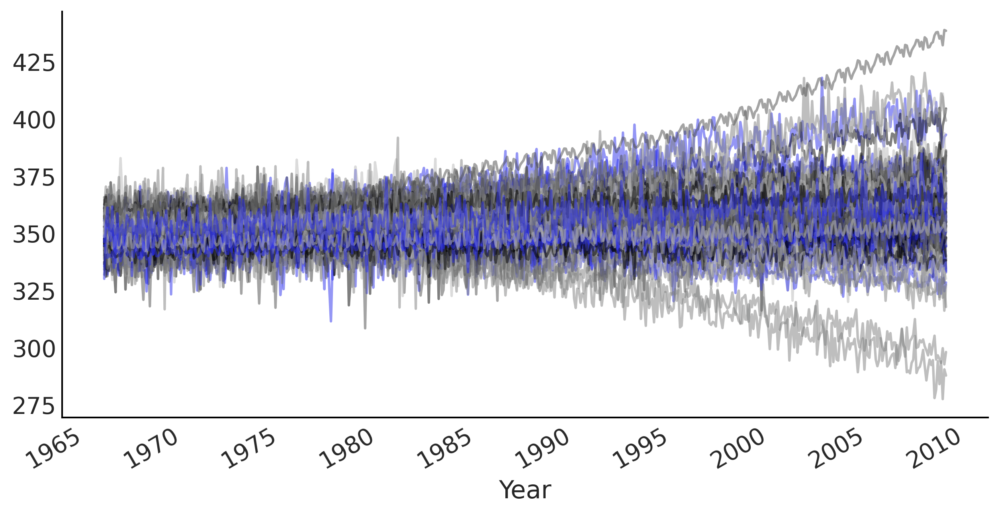

In [19]:
prior_samples = gam.sample(100)
prior_predictive_timeseries = prior_samples[-1]

fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(co2_by_month.index[:-num_forecast_steps],
        tf.transpose(prior_predictive_timeseries), alpha=.5)
ax.set_xlabel("Year")
fig.autofmt_xdate()

plt.savefig("img/chp06/fig8_prior_predictive2.png");

In [ ]:
%%time
mcmc_samples, sampler_stats = run_mcmc(
    1000, gam, n_chains=4, num_adaptation_steps=1000,
    seed=tf.constant([-12341, 62345], dtype=tf.int32),
    observed=co2_by_month_training_data.T)

In [ ]:
gam_idata = az.from_dict(
    posterior={
        k:np.swapaxes(v.numpy(), 1, 0)
        for k, v in mcmc_samples._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]}
)

axes = az.plot_trace(gam_idata, compact=True);

In [ ]:
gam_full = gen_gam_jd(training=False)
posterior_dists, _ = gam_full.sample_distributions(value=mcmc_samples)

In [ ]:
# plot components
_, ax = plt.subplots(2, 1, figsize=(10, 5))

k, m, tau, delta = mcmc_samples[1:5]
growth_rate = k[..., None] + tf.einsum('ij,...j->...i', A, delta)
offset = m[..., None] + tf.einsum('ij,...j->...i', A, -s * delta)
trend_posterior = growth_rate * t + offset
seasonality_posterior = tf.einsum('ij,...j->...i', X_pred, mcmc_samples[0])

for i in range(nchains):
    ax[0].plot(co2_by_month.index,
               trend_posterior[-100:, i, :].numpy().T, alpha=.05)
    ax[1].plot(co2_by_month.index,
               seasonality_posterior[-100:, i, :].numpy().T, alpha=.05)

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10, 5))

# fitted_with_forecast = posterior_dists[-1].distribution.mean().numpy()
fitted_with_forecast = posterior_dists[-1].distribution.sample().numpy()

ax.plot(co2_by_month.index, fitted_with_forecast[-100:, 0, :].T, color='gray', alpha=.1);
ax.plot(co2_by_month.index, fitted_with_forecast[-100:, 1, :].T, color='gray', alpha=.1);

plot_co2_data((fig, ax));

average_forecast = np.mean(fitted_with_forecast, axis=(0, 1)).T
ax.plot(co2_by_month.index, average_forecast, ls='--', label='GAM forecast', alpha=.5);

plt.savefig("img/chp06/fig9_posterior_predictive2.png");

# Autoregressive

In [ ]:
n_t = 200

@tfd.JointDistributionCoroutine
def ar1_with_forloop():
    sigma = yield root(tfd.HalfNormal(1.))
    rho = yield root(tfd.Uniform(-1., 1.))
    x0 = yield tfd.Normal(0., sigma)
    x = [x0]
    for i in range(1, n_t):
        x_i = yield tfd.Normal(x[i-1] * rho, sigma)
        x.append(x_i)

nplot = 4
fig, axes = plt.subplots(nplot, 1)
for ax, rho in zip(axes, np.linspace(-1.01, 1.01, nplot)):
    test_samples = ar1_with_forloop.sample(value=(1., rho))
    ar1_samples = tf.stack(test_samples[2:])
    ax.plot(ar1_samples, alpha=.5, label=r'$\rho$=%.2f' % rho)
    ax.legend(bbox_to_anchor=(1, 1), loc='upper left',
              borderaxespad=0., fontsize=10)
    ax.get_xaxis().set_visible(False)
fig.suptitle(r'AR(1) process with varies autoregressive coefficient ($\rho$)')

plt.savefig("img/chp06/fig10_ar1_process.png")

In [ ]:
@tfd.JointDistributionCoroutine
def ar1_without_forloop():
    sigma = yield root(tfd.HalfNormal(1.))
    rho = yield root(tfd.Uniform(-1., 1.))

    def ar1_fun(x):
        # We apply the backshift operation here
        x_tm1 = tf.concat([tf.zeros_like(x[..., :1]), x[..., :-1]], axis=-1)
        loc = x_tm1 * rho[..., None]
        return tfd.Independent(tfd.Normal(loc=loc, scale=sigma[..., None]),
                               reinterpreted_batch_ndims=1)

    dist = yield tfd.Autoregressive(
        distribution_fn=ar1_fun,
        sample0=tf.zeros([n_t], dtype=rho.dtype),
        num_steps=n_t)

seed = [1000, 5234]
_, ax = plt.subplots(figsize=(10, 5))
rho = np.linspace(-1.01, 1.01, 5)
sigma = np.ones(5)
test_samples = ar1_without_forloop.sample(value=(sigma, rho), seed=seed)
ar1_samples = tf.transpose(test_samples[-1])
ax.plot(ar1_samples, alpha=.5)
ax.set_title('AR(1) process with varies autoregressive coefficient (rho)');

A more general way to implement this is to use a Lag operator $B$

In [ ]:
B = np.diag(np.ones(5 - 1), -1)
B @ B

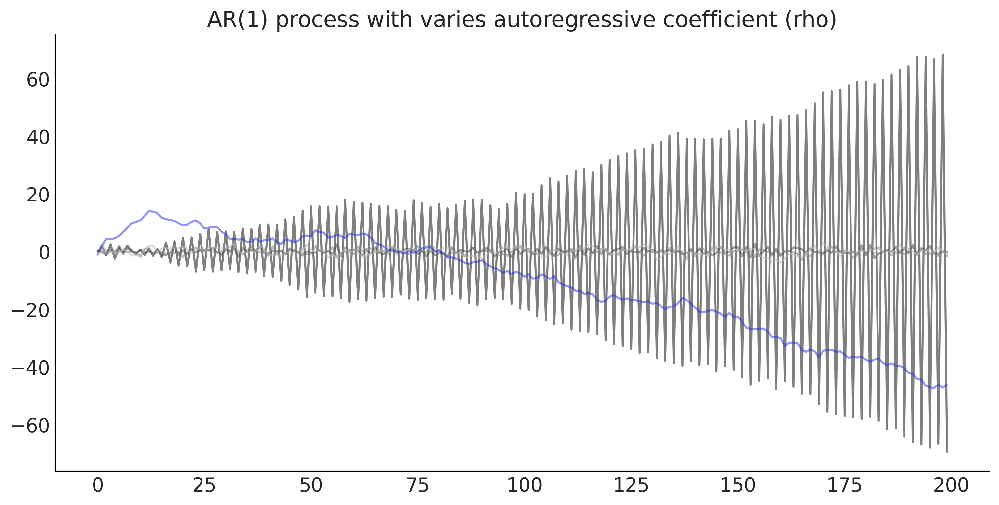

In [28]:
B = np.diag(np.ones(n_t - 1), -1)

@tfd.JointDistributionCoroutine
def ar1_lag_operator():
    sigma = yield root(tfd.HalfNormal(1., name='sigma'))
    rho = yield root(tfd.Uniform(-1., 1., name='rho'))

    def ar1_fun(x):
        loc = tf.einsum('ij,...j->...i', B, x) * rho[..., None]
        return tfd.Independent(tfd.Normal(loc=loc, scale=sigma[..., None]),
                               reinterpreted_batch_ndims=1)

    dist = yield tfd.Autoregressive(
            distribution_fn=ar1_fun, 
            sample0=tf.zeros([n_t], dtype=rho.dtype),
            num_steps=n_t,
            name="ar1")


_, ax = plt.subplots(figsize=(10, 5))
rho = np.linspace(-1.01, 1.01, 5)
sigma = np.ones(5)
test_samples = ar1_lag_operator.sample(value=(sigma, rho), seed=seed)
ar1_samples = tf.transpose(test_samples[-1])
ax.plot(ar1_samples, alpha=.5)
ax.set_title('AR(1) process with varies autoregressive coefficient (rho)');

Note that since we are using a stateless RNG seeding, we got the same result (yay!)

In [29]:
def gam_trend_seasonality():
    beta = yield root(tfd.Sample(
        tfd.Normal(0., 1.),
        sample_shape=n_pred,
        name='beta'))
    seasonality = tf.einsum('ij,...j->...i', X_pred, beta)

    k = yield root(tfd.HalfNormal(10., name='k'))
    m = yield root(tfd.Normal(
        co2_by_month_training_data['CO2'].mean(), scale=5., name='m'))
    tau = yield root(tfd.HalfNormal(10., name='tau'))
    delta = yield tfd.Sample(tfd.Laplace(0., tau),
                             sample_shape=n_changepoints,
                             name='delta')

    growth_rate = k[..., None] + tf.einsum('ij,...j->...i', A, delta)
    offset = m[..., None] + tf.einsum('ij,...j->...i', A, -s * delta)
    trend = growth_rate * t + offset
    noise_sigma = yield root(tfd.HalfNormal(scale=5., name='noise_sigma'))
    return seasonality, trend, noise_sigma


def generate_gam(training=True):

    @tfd.JointDistributionCoroutine
    def gam():
        seasonality, trend, noise_sigma = yield from gam_trend_seasonality()
        y_hat = seasonality + trend
        if training:
            y_hat = y_hat[..., :co2_by_month_training_data.shape[0]]

        # likelihood
        observed = yield tfd.Independent(
            tfd.Normal(y_hat, noise_sigma[..., None]),
            reinterpreted_batch_ndims=1,
            name='observed'
        )

    return gam

gam = generate_gam()

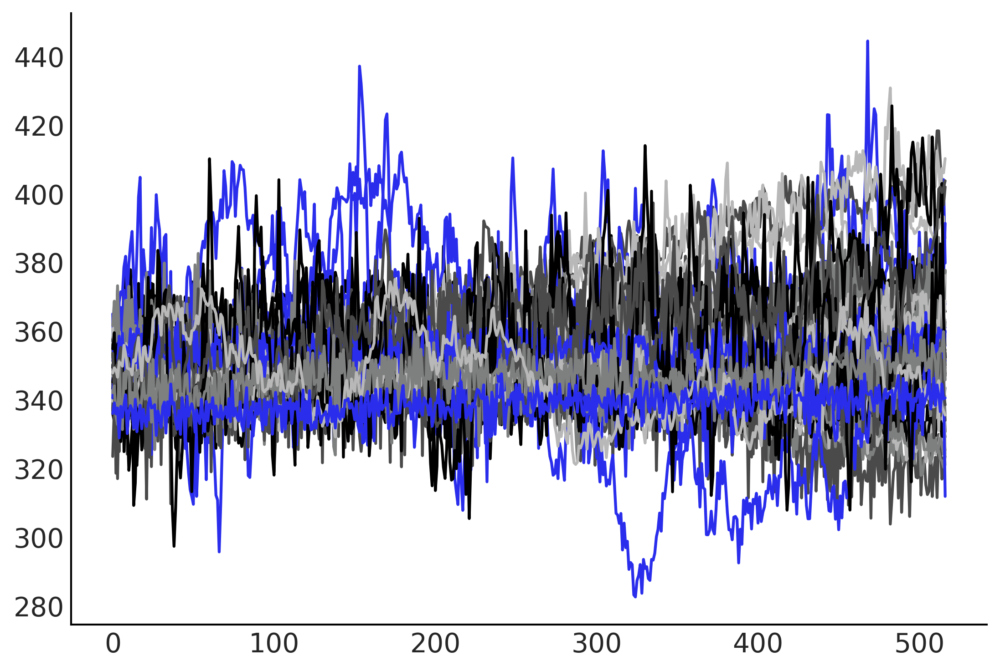

In [30]:
def generate_gam_ar_likelihood(training=True):

    @tfd.JointDistributionCoroutine
    def gam_with_ar_likelihood():
        seasonality, trend, noise_sigma = yield from gam_trend_seasonality()
        y_hat = seasonality + trend
        if training:
            y_hat = y_hat[..., :co2_by_month_training_data.shape[0]]

        # Likelihood
        rho = yield root(tfd.Uniform(-1., 1., name="rho"))
        def ar_fun(y):
            noise = y - y_hat
            loc = tf.concat([tf.zeros_like(noise[..., :1]), noise[..., :-1]],
                            axis=-1) * rho[..., None]
            return tfd.Independent(
                tfd.Normal(loc=loc+y_hat, scale=noise_sigma[..., None]),
                reinterpreted_batch_ndims=1)
        observed = yield tfd.Autoregressive(
            distribution_fn=ar_fun,
            sample0=tf.zeros_like(y_hat),
            num_steps=trend.shape[-1],
            name="observed")
    return gam_with_ar_likelihood


gam_with_ar_likelihood = generate_gam_ar_likelihood()

plt.plot(tf.transpose(gam_with_ar_likelihood.sample(50)[-1]));

In [31]:
%%time
mcmc_samples, sampler_stats = run_mcmc(
    1000, gam_with_ar_likelihood, n_chains=4, num_adaptation_steps=1000,
    seed=tf.constant([-234272345, 73564234], dtype=tf.int32),
    observed=co2_by_month_training_data.T)

2021-10-18 16:16:16.406168: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator mcmc_retry_init/assert_equal_1/Assert/AssertGuard/Assert


CPU times: user 3min 14s, sys: 7.41 s, total: 3min 22s
Wall time: 3min 23s


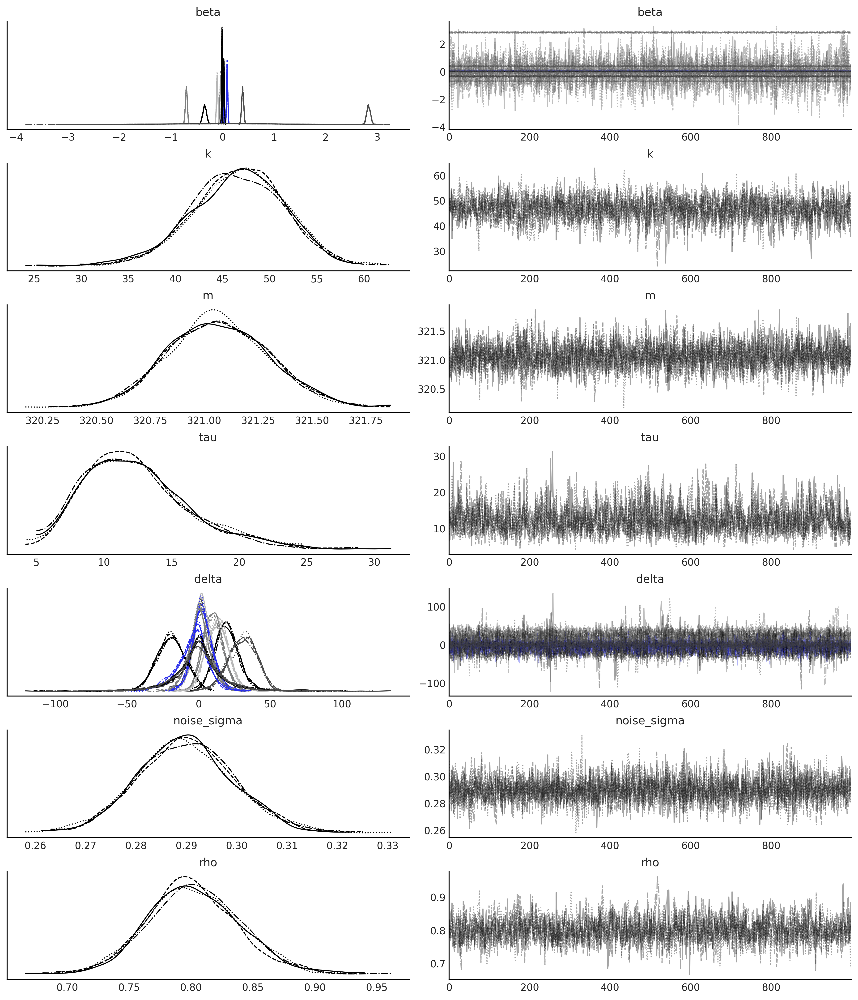

In [32]:
gam_ar_likelihood_idata = az.from_dict(
    posterior={
        k:np.swapaxes(v.numpy(), 1, 0)
        for k, v in mcmc_samples._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]}
)

axes = az.plot_trace(gam_ar_likelihood_idata, compact=True);

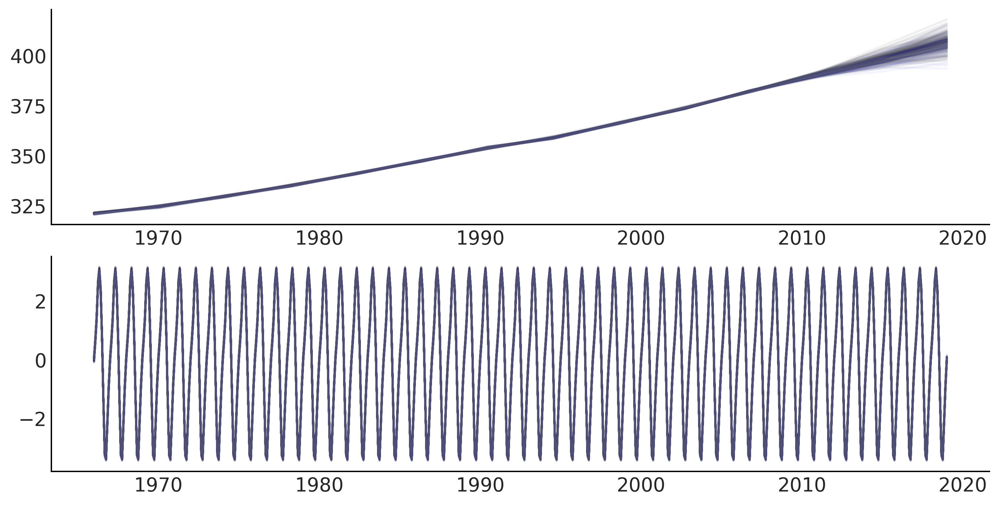

In [33]:
# plot components
_, ax = plt.subplots(2, 1, figsize=(10, 5))

k, m, tau, delta = mcmc_samples[1:5]
growth_rate = k[..., None] + tf.einsum('ij,...j->...i', A, delta)
offset = m[..., None] + tf.einsum('ij,...j->...i', A, -s * delta)
trend_posterior = growth_rate * t + offset
seasonality_posterior = tf.einsum('ij,...j->...i', X_pred, mcmc_samples[0])

for i in range(nchains):
    ax[0].plot(co2_by_month.index,
               trend_posterior[-100:, i, :].numpy().T, alpha=.05)
    ax[1].plot(co2_by_month.index,
               seasonality_posterior[-100:, i, :].numpy().T, alpha=.05)

/var/folders/7p/srk5qjp563l5f9mrjtp44bh800jqsw/T/ipykernel_72521/1698526664.py:19: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.autofmt_xdate()


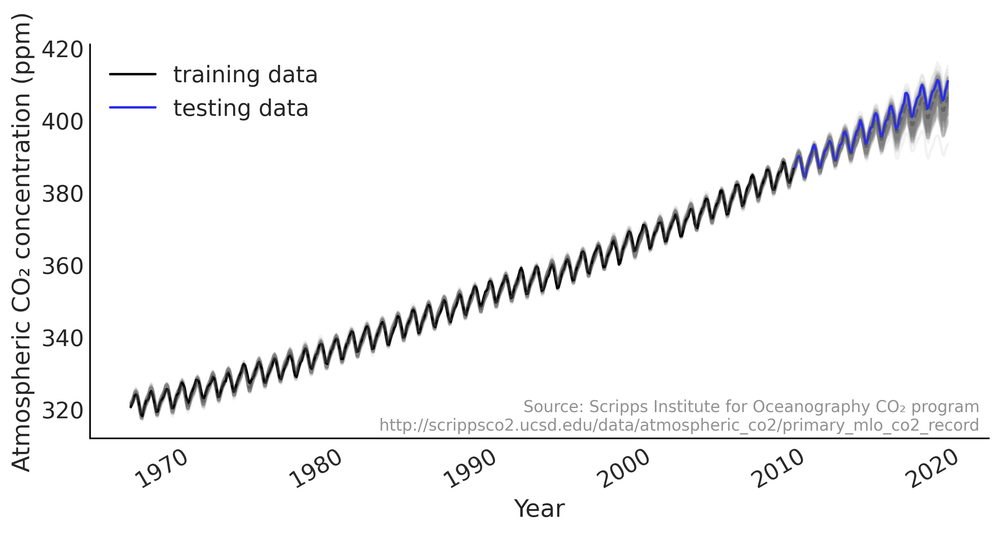

In [34]:
gam_with_ar_likelihood_full = generate_gam_ar_likelihood(training=False)
_, values = gam_with_ar_likelihood_full.sample_distributions(value=mcmc_samples)
fitted_with_forecast = values[-1].numpy()

fig, ax = plt.subplots(1, 1, figsize=(10, 5))

ax.plot(co2_by_month.index, fitted_with_forecast[-100:, 0, :].T, color='gray', alpha=.1);
ax.plot(co2_by_month.index, fitted_with_forecast[-100:, 1, :].T, color='gray', alpha=.1);

plot_co2_data((fig, ax));

average_forecast = np.mean(fitted_with_forecast, axis=(0, 1)).T
ax.plot(co2_by_month.index, average_forecast, ls='--', label='GAM forecast', alpha=.5);

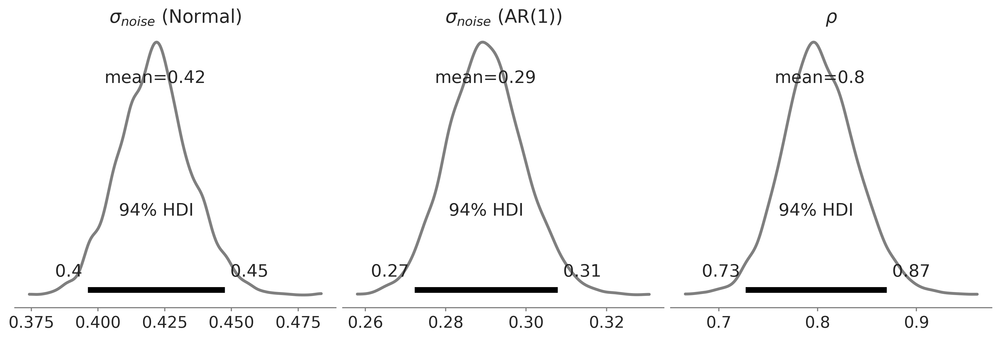

In [35]:
fig, axes = plt.subplots(1, 3, figsize=(4*3, 4))
az.plot_posterior(gam_idata, var_names=['noise_sigma'], alpha=.5, lw=2.5, ax=axes[0]);
axes[0].set_title(r'$\sigma_{noise}$ (Normal)')

az.plot_posterior(gam_ar_likelihood_idata, var_names=['noise_sigma', 'rho'], alpha=.5, lw=2.5, ax=axes[1:]);
axes[1].set_title(r'$\sigma_{noise}$ (AR(1))')
axes[2].set_title(r'$\rho$')

plt.savefig("img/chp06/fig11_ar1_likelihood_rho.png");

## Latent AR component

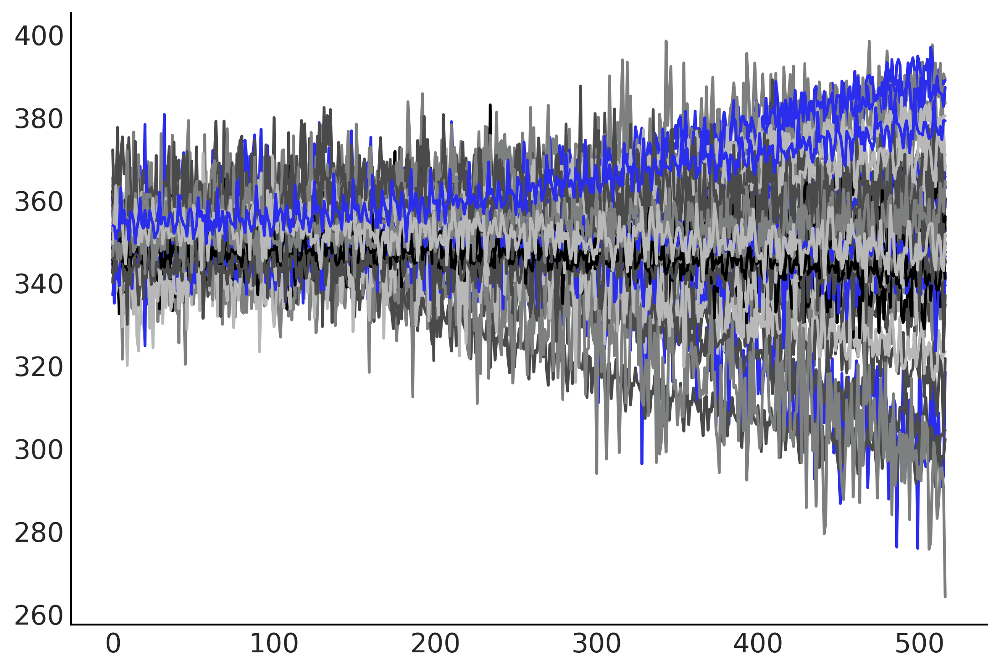

In [36]:
def generate_gam_ar_latent(training=True):

    @tfd.JointDistributionCoroutine
    def gam_with_latent_ar():
        seasonality, trend, noise_sigma = yield from gam_trend_seasonality()
        
        # Latent AR(1)
        ar_sigma = yield root(tfd.HalfNormal(.1, name='ar_sigma'))
        rho = yield root(tfd.Uniform(-1., 1., name='rho'))
        def ar_fun(y):
            loc = tf.concat([tf.zeros_like(y[..., :1]), y[..., :-1]],
                            axis=-1) * rho[..., None]
            return tfd.Independent(
                tfd.Normal(loc=loc, scale=ar_sigma[..., None]),
                reinterpreted_batch_ndims=1)
        temporal_error = yield tfd.Autoregressive(
            distribution_fn=ar_fun,
            sample0=tf.zeros_like(trend),
            num_steps=trend.shape[-1],
            name='temporal_error')

        # Linear prediction
        y_hat = seasonality + trend + temporal_error
        if training:
            y_hat = y_hat[..., :co2_by_month_training_data.shape[0]]

        # Likelihood
        observed = yield tfd.Independent(
            tfd.Normal(y_hat, noise_sigma[..., None]),
            reinterpreted_batch_ndims=1,
            name='observed'
        )

    return gam_with_latent_ar

gam_with_latent_ar = generate_gam_ar_latent()

plt.plot(tf.transpose(gam_with_latent_ar.sample(50)[-1]));

In [37]:
# a NUTS sampling routine with simple tuning
from tensorflow_probability.python.internal import unnest
from tensorflow_probability.python.internal import samplers


def run_mcmc_simple(
    n_draws,
    joint_dist,
    n_chains=4,
    num_adaptation_steps=1000,
    return_compiled_function=False,
    target_log_prob_fn=None,
    bijector=None,
    init_state=None,
    seed=None,
    **pins):
    joint_dist_pinned = joint_dist.experimental_pin(**pins) if pins else joint_dist
    if bijector is None:
        bijector = joint_dist_pinned.experimental_default_event_space_bijector()
    if target_log_prob_fn is None:
        target_log_prob_fn = joint_dist_pinned.unnormalized_log_prob

    if seed is None:
        seed = 26401
    run_mcmc_seed = samplers.sanitize_seed(seed, salt='run_mcmc_seed')

    if init_state is None:
        if pins:
            init_state_ = joint_dist_pinned.sample_unpinned(n_chains)
        else:
            init_state_ = joint_dist_pinned.sample(n_chains)
        ini_state_unbound = bijector.inverse(init_state_)
        run_mcmc_seed, *init_seed = samplers.split_seed(
            run_mcmc_seed, n=len(ini_state_unbound)+1)
        init_state = bijector.forward(
            tf.nest.map_structure(
                lambda x, seed: tfd.Uniform(-1., tf.constant(1., x.dtype)).sample(
                    x.shape, seed=seed),
                ini_state_unbound,
                tf.nest.pack_sequence_as(ini_state_unbound, init_seed)))

    @tf.function(autograph=False, jit_compile=True)
    def run_inference_nuts(init_state, draws, tune, seed):
        seed, tuning_seed, sample_seed = samplers.split_seed(seed, n=3)

        def gen_kernel(step_size):
            hmc = tfp.mcmc.NoUTurnSampler(
                target_log_prob_fn=target_log_prob_fn, step_size=step_size)
            hmc = tfp.mcmc.TransformedTransitionKernel(
                hmc, bijector=bijector)
            tuning_hmc = tfp.mcmc.DualAveragingStepSizeAdaptation(
                hmc, tune // 2, target_accept_prob=0.85)
            return tuning_hmc

        def tuning_trace_fn(_, pkr):
            return pkr.inner_results.transformed_state, pkr.new_step_size

        def get_tuned_stepsize(samples, step_size):
            return tf.math.reduce_std(samples, axis=0) * step_size[-1]

        step_size = tf.nest.map_structure(
            tf.ones_like, bijector.inverse(init_state))
        tuning_hmc = gen_kernel(step_size)
        init_samples, (sample_unbounded, tuning_step_size) = tfp.mcmc.sample_chain(
            num_results=200,
            num_burnin_steps=tune // 2 - 200,
            current_state=init_state,
            kernel=tuning_hmc,
            trace_fn=tuning_trace_fn,
            seed=tuning_seed)

        tuning_step_size = tf.nest.pack_sequence_as(
            sample_unbounded, tuning_step_size)
        step_size_new = tf.nest.map_structure(get_tuned_stepsize,
                                              sample_unbounded,
                                              tuning_step_size)
        sample_hmc = gen_kernel(step_size_new)

        def sample_trace_fn(_, pkr):
            energy_diff = unnest.get_innermost(pkr, 'log_accept_ratio')
            return {
                'target_log_prob': unnest.get_innermost(pkr, 'target_log_prob'),
                'n_steps': unnest.get_innermost(pkr, 'leapfrogs_taken'),
                'diverging': unnest.get_innermost(pkr, 'has_divergence'),
                'energy': unnest.get_innermost(pkr, 'energy'),
                'accept_ratio': tf.minimum(1., tf.exp(energy_diff)),
                'reach_max_depth': unnest.get_innermost(pkr, 'reach_max_depth'),
            }
        current_state = tf.nest.map_structure(lambda x: x[-1], init_samples)
        return tfp.mcmc.sample_chain(
            num_results=draws,
            num_burnin_steps=tune // 2,
            current_state=current_state,
            kernel=sample_hmc,
            trace_fn=sample_trace_fn,
            seed=sample_seed)

    mcmc_samples, mcmc_diagnostic = run_inference_nuts(
        init_state, n_draws, num_adaptation_steps, run_mcmc_seed)

    if return_compiled_function:
        return mcmc_samples, mcmc_diagnostic, run_inference_nuts
    else:
        return mcmc_samples, mcmc_diagnostic

In [38]:
%%time
mcmc_samples, sampler_stats = run_mcmc_simple(
    1000, gam_with_latent_ar, n_chains=4, num_adaptation_steps=1000,
    seed=tf.constant([936245, 734564], dtype=tf.int32),
    observed=co2_by_month_training_data.T)

CPU times: user 2min 59s, sys: 1.67 s, total: 3min 1s
Wall time: 3min


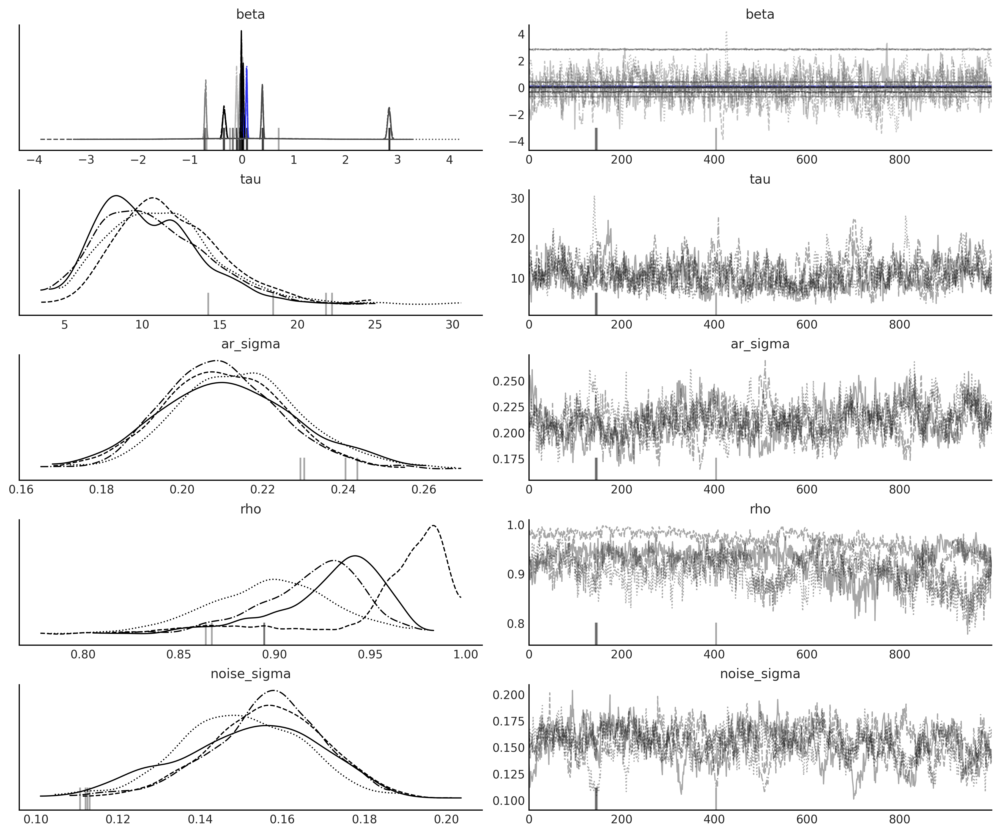

In [39]:
nuts_trace_ar_latent = az.from_dict(
    posterior={
        k:np.swapaxes(v.numpy(), 1, 0)
        for k, v in mcmc_samples._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]}
)

axes = az.plot_trace(
    nuts_trace_ar_latent,
    var_names=['beta', 'tau', 'ar_sigma', 'rho', 'noise_sigma'],
    compact=True);

In [40]:
gam_with_latent_ar_full = generate_gam_ar_latent(training=False)
posterior_dists, ppc_samples = gam_with_latent_ar_full.sample_distributions(value=mcmc_samples)

/var/folders/7p/srk5qjp563l5f9mrjtp44bh800jqsw/T/ipykernel_35944/4037595605.py:23: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.autofmt_xdate()


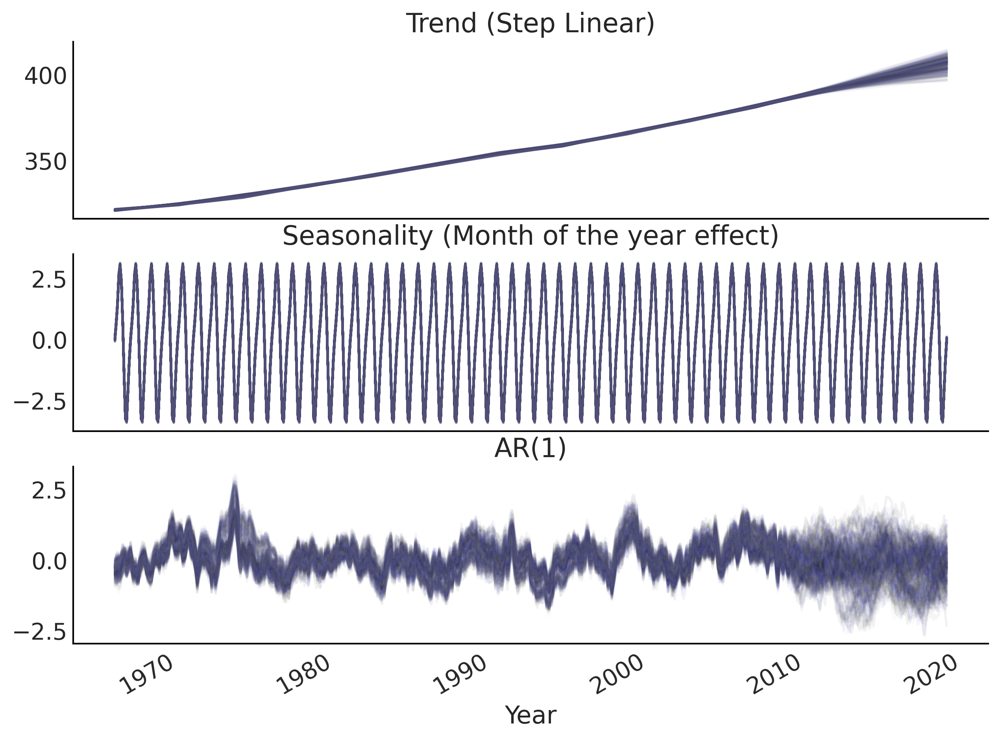

In [41]:
# plot components
fig, ax = plt.subplots(3, 1, figsize=(10, 7.5), sharex=True)

beta, k, m, tau, delta = mcmc_samples[:5]
growth_rate = k[..., None] + tf.einsum('ij,...j->...i', A, delta)
offset = m[..., None] + tf.einsum('ij,...j->...i', A, -s * delta)
trend_posterior = growth_rate * t + offset
seasonality_posterior = tf.einsum('ij,...j->...i', X_pred, beta)
temporal_error = mcmc_samples[-1]
# temporal_error_ = mcmc_samples[7]
# temporal_error = tf.concat([tf.zeros_like(temporal_error_[..., :1]),
#                             temporal_error_], axis=-1)

for i in range(nchains):
    ax[0].plot(co2_by_month.index, trend_posterior[-100:, i, :].numpy().T, alpha=.05);
    ax[1].plot(co2_by_month.index, seasonality_posterior[-100:, i, :].numpy().T, alpha=.05);
    ax[2].plot(co2_by_month.index, temporal_error[-100:, i, :].numpy().T, alpha=.05);

ax[0].set_title('Trend (Step Linear)')
ax[1].set_title('Seasonality (Month of the year effect)')
ax[2].set_title('AR(1)')
ax[2].set_xlabel("Year")
fig.autofmt_xdate()

plt.savefig("img/chp06/fig12_posterior_predictive_ar1.png");

/var/folders/7p/srk5qjp563l5f9mrjtp44bh800jqsw/T/ipykernel_35944/1698526664.py:19: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.autofmt_xdate()


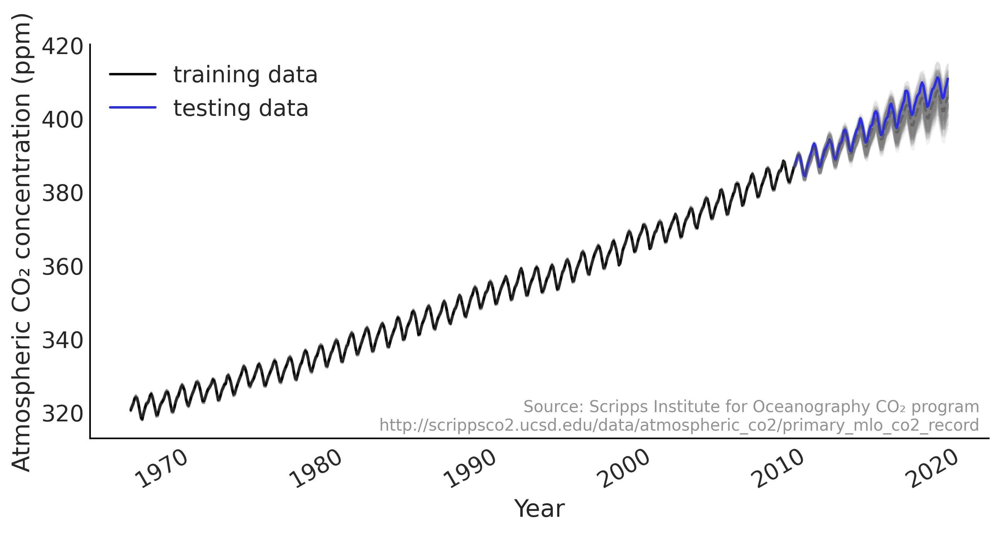

In [42]:
fig, ax = plt.subplots(1, 1, figsize=(10, 5))

# fitted_with_forecast = posterior_dists[-1].distribution.mean().numpy()
# fitted_with_forecast = posterior_dists[-1].distribution.sample().numpy()
fitted_with_forecast = ppc_samples[-1].numpy()

ax.plot(co2_by_month.index, fitted_with_forecast[-100:, 0, :].T, color='gray', alpha=.1);
ax.plot(co2_by_month.index, fitted_with_forecast[-100:, 1, :].T, color='gray', alpha=.1);

plot_co2_data((fig, ax));

average_forecast = np.mean(fitted_with_forecast, axis=(0, 1)).T
ax.plot(co2_by_month.index, average_forecast, ls='--', label='GAM forecast', alpha=.5);

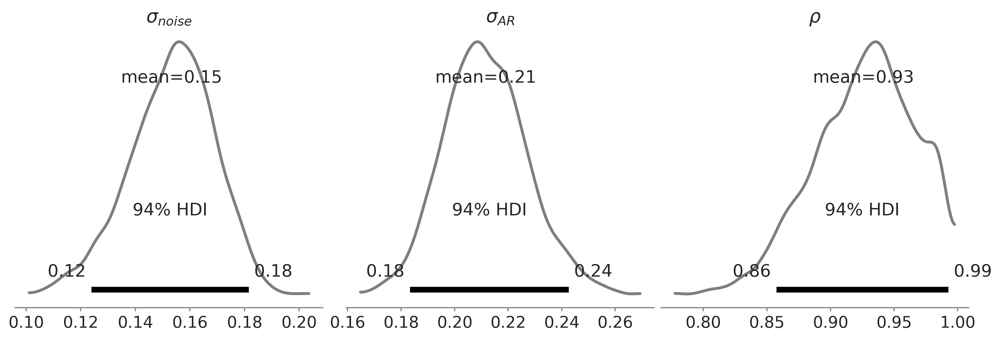

In [43]:
axes = az.plot_posterior(
    nuts_trace_ar_latent, 
    var_names=['noise_sigma', 'ar_sigma', 'rho'], 
    alpha=.5, lw=2.5, 
    figsize=(4*3, 4));
axes[0].set_title(r'$\sigma_{noise}$')
axes[1].set_title(r'$\sigma_{AR}$')
axes[2].set_title(r'$\rho$')

plt.savefig("img/chp06/fig13_ar1_likelihood_rho2.png");

### Reflection on autoregressive and smoothing

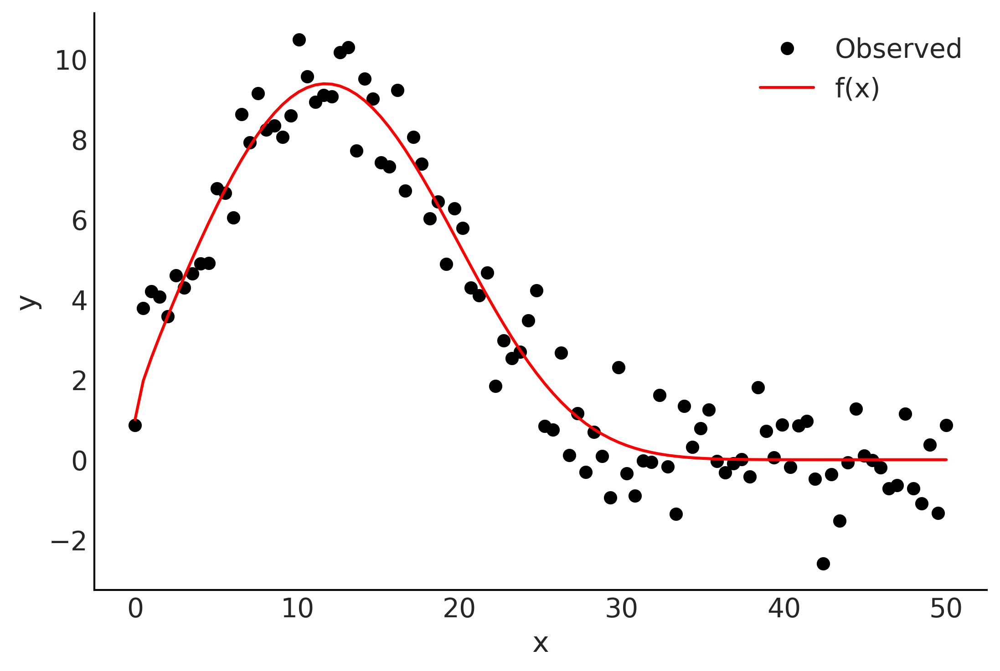

In [44]:
num_steps = 100

x = np.linspace(0, 50, num_steps)
f = np.exp(1.0 + np.power(x, 0.5) - np.exp(x/15.0))
y = f + np.random.normal(scale=1.0, size=x.shape)

plt.plot(x, y, 'ok', label='Observed')
plt.plot(x, f, 'r', label='f(x)')
plt.legend()
plt.xlabel('x');
plt.ylabel('y');

In [45]:
@tfd.JointDistributionCoroutine
def smoothing_grw():
    alpha = yield root(tfd.Beta(5, 1.))
    variance = yield root(tfd.HalfNormal(10.))
    sigma0 = tf.sqrt(variance * alpha)
    sigma1 = tf.sqrt(variance * (1. - alpha))
    z = yield tfd.Sample(tfd.Normal(0., sigma0), num_steps)
    observed = yield tfd.Independent(
        tfd.Normal(tf.math.cumsum(z, axis=-1), sigma1[..., None]),
        name='observed'
    )

In [46]:
%%time
mcmc_samples, sampler_stats = run_mcmc(
    1000, smoothing_grw, n_chains=4, num_adaptation_steps=1000,
    observed=tf.constant(y[None, ...], dtype=tf.float32))

Instructions for updating:
Please pass an integer value for `reinterpreted_batch_ndims`. The current behavior corresponds to `reinterpreted_batch_ndims=tf.size(distribution.batch_shape_tensor()) - 1`.


2021-09-17 11:15:46.233424: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator mcmc_retry_init/assert_equal_1/Assert/AssertGuard/Assert


CPU times: user 41 s, sys: 593 ms, total: 41.6 s
Wall time: 41.3 s


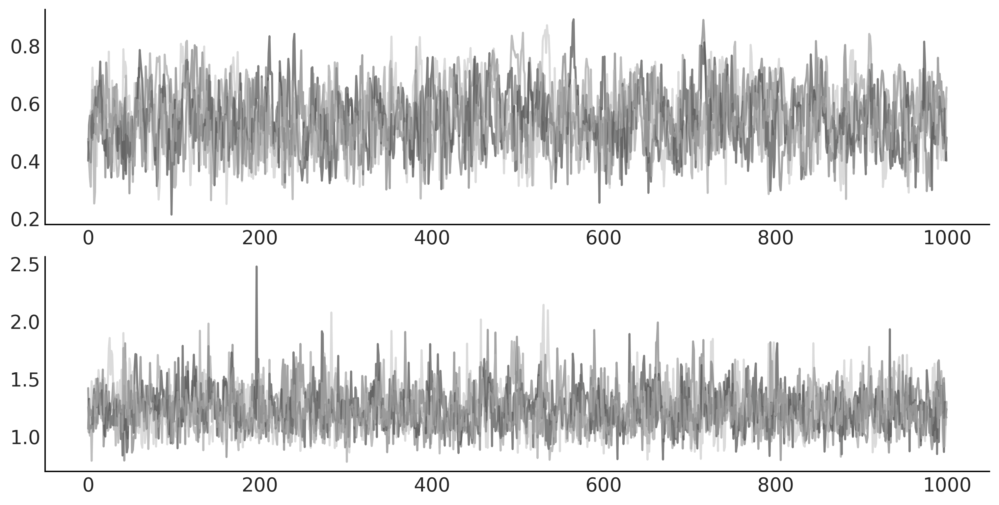

In [47]:
_, ax = plt.subplots(2, 1, figsize=(10, 5))
ax[0].plot(mcmc_samples[0], alpha=.5)
ax[1].plot(mcmc_samples[1], alpha=.5);

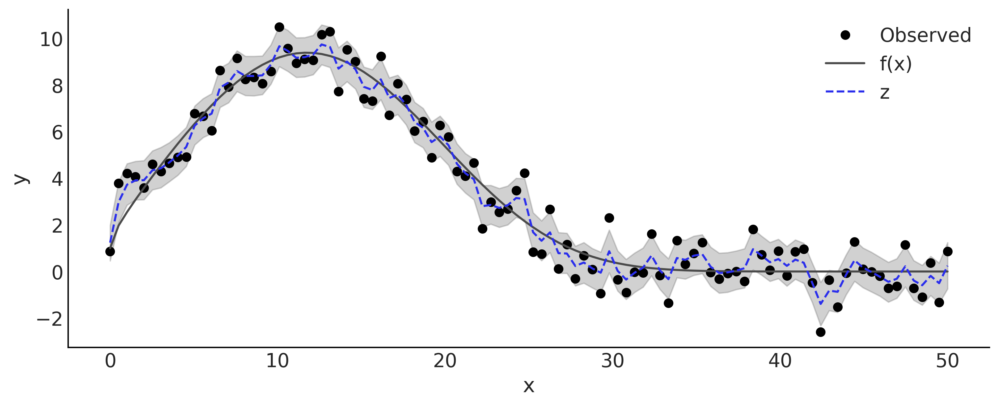

In [48]:
nsample, nchain = mcmc_samples[-1].shape[:2]

z = tf.reshape(tf.math.cumsum(mcmc_samples[-1], axis=-1), [nsample*nchain, -1])
lower, upper = np.percentile(z, [5, 95], axis=0)

_, ax = plt.subplots(figsize=(10, 4))

ax.plot(x, y, 'o', label='Observed')
ax.plot(x, f, label='f(x)')
ax.fill_between(x, lower, upper, color='C1', alpha=.25)
ax.plot(x, tf.reduce_mean(z, axis=0), color='C4', ls='--', label='z')
ax.legend()
ax.set_xlabel('x');
ax.set_ylabel('y');

plt.savefig("img/chp06/fig14_smoothing_with_gw.png");

# SARIMA

/var/folders/7p/srk5qjp563l5f9mrjtp44bh800jqsw/T/ipykernel_35944/1306182099.py:21: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.autofmt_xdate()


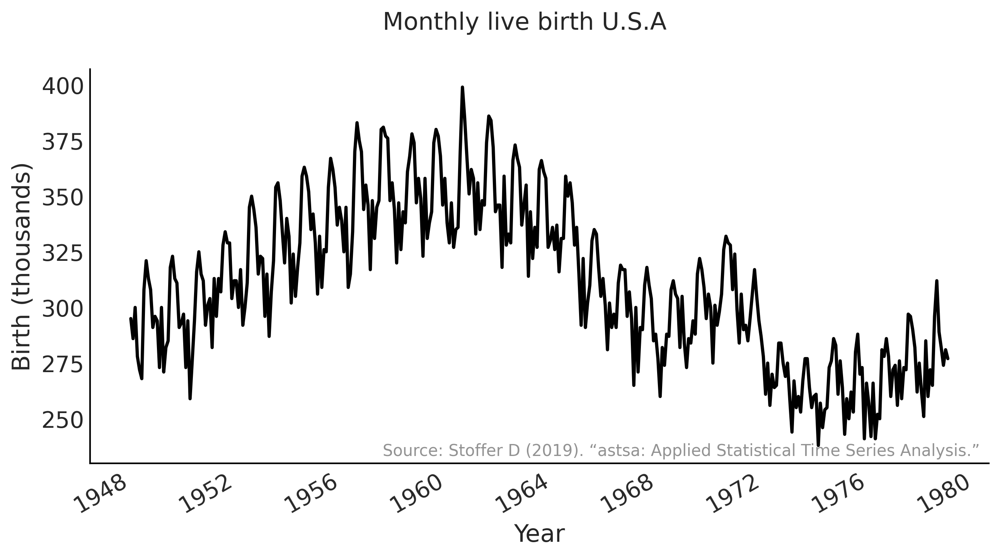

In [49]:
us_monthly_birth = pd.read_csv("../data/monthly_birth_usa.csv")
us_monthly_birth["date_month"] = pd.to_datetime(us_monthly_birth["date_month"])
us_monthly_birth.set_index("date_month", drop=True, inplace=True)

def plot_birth_data(fig_ax=None):
    if not fig_ax:
        fig, ax = plt.subplots(1, 1, figsize=(10, 5))
    else:
        fig, ax = fig_ax
    
    ax.plot(us_monthly_birth, lw=2)
    ax.set_ylabel("Birth (thousands)")
    ax.set_xlabel("Year")
    fig.suptitle("Monthly live birth U.S.A",
                 fontsize=15)
    ax.text(0.99, .02,
            "Source: Stoffer D (2019). “astsa: Applied Statistical Time Series Analysis.”",
            transform=ax.transAxes,
            horizontalalignment="right",
            alpha=0.5)
    fig.autofmt_xdate()
    return fig, ax


_ = plot_birth_data()

plt.savefig("img/chp06/fig15_birth_by_month.png")

### y ~ Sarima(1,1,1)(1,1,1)[12]

In [50]:
# y ~ Sarima(1,1,1)(1,1,1)[12]
p, d, q = (1, 1, 1)
P, D, Q, period = (1, 1, 1, 12)
# Time series data: us_monthly_birth.shape = (372,)
observed = us_monthly_birth["birth_in_thousands"].values
# Integrated to seasonal order $D$
for _ in range(D):
    observed = observed[period:] - observed[:-period]
# Integrated to order $d$
observed = tf.constant(np.diff(observed, n=d), tf.float32)

r = max(p, q, P * period, Q * period)
def likelihood(mu0, sigma, phi, theta, sphi, stheta):
    batch_shape = tf.shape(mu0)
    y_extended = tf.concat(
        [tf.zeros(tf.concat([[r], batch_shape], axis=0), dtype=mu0.dtype),
        tf.einsum('...,j->j...',
                  tf.ones_like(mu0, dtype=observed.dtype),
                  observed)],
        axis=0)
    eps_t = tf.zeros_like(y_extended, dtype=observed.dtype)

    def arma_onestep(t, eps_t):
        t_shift = t + r
        # AR
        y_past = tf.gather(y_extended, t_shift - (np.arange(p) + 1))
        ar = tf.einsum("...p,p...->...", phi, y_past)
        # MA
        eps_past = tf.gather(eps_t, t_shift - (np.arange(q) + 1))
        ma = tf.einsum("...q,q...->...", theta, eps_past)
        # Seasonal AR
        sy_past = tf.gather(y_extended, t_shift - (np.arange(P) + 1) * period)
        sar = tf.einsum("...p,p...->...", sphi, sy_past)
        # Seasonal MA
        seps_past = tf.gather(eps_t, t_shift - (np.arange(Q) + 1) * period)
        sma = tf.einsum("...q,q...->...", stheta, seps_past)

        mu_at_t = ar + ma + sar + sma + mu0
        eps_update = tf.gather(y_extended, t_shift) - mu_at_t
        epsilon_t_next = tf.tensor_scatter_nd_update(
            eps_t, [[t_shift]], eps_update[None, ...])
        return t+1, epsilon_t_next

    t, eps_output_ = tf.while_loop(
        lambda t, *_: t < observed.shape[-1],
        arma_onestep,
        loop_vars=(0, eps_t),
        maximum_iterations=observed.shape[-1])
    eps_output = eps_output_[r:]
    return tf.reduce_sum(
        tfd.Normal(0, sigma[None, ...]).log_prob(eps_output), axis=0)

In [51]:
@tfd.JointDistributionCoroutine
def sarima_priors():
    mu0 = yield root(tfd.StudentT(df=6, loc=0, scale=2.5, name='mu0'))
    sigma = yield root(tfd.HalfStudentT(df=7, loc=0, scale=1., name='sigma'))

    # phi = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), p, name='phi'))
    phi = yield root(
        tfd.Sample(
            tfd.TransformedDistribution(
                tfd.Beta(concentration1=2., concentration0=2.),
                tfb.Shift(-1.)(tfb.Scale(2.))),
            p, name='phi')
    )
    theta = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), q, name='theta'))
    sphi = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), P, name='sphi'))
    stheta = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), Q, name='stheta'))

In [58]:
%%time
target_log_prob_fn = lambda *x: sarima_priors.log_prob(*x) + likelihood(*x)

mcmc_samples, sampler_stats = run_mcmc_simple(
    1000, sarima_priors, n_chains=4, num_adaptation_steps=1000,
    target_log_prob_fn=target_log_prob_fn,
    seed=tf.constant([623453, 456345], dtype=tf.int32),
)

CPU times: user 31.7 s, sys: 944 ms, total: 32.7 s
Wall time: 32.2 s


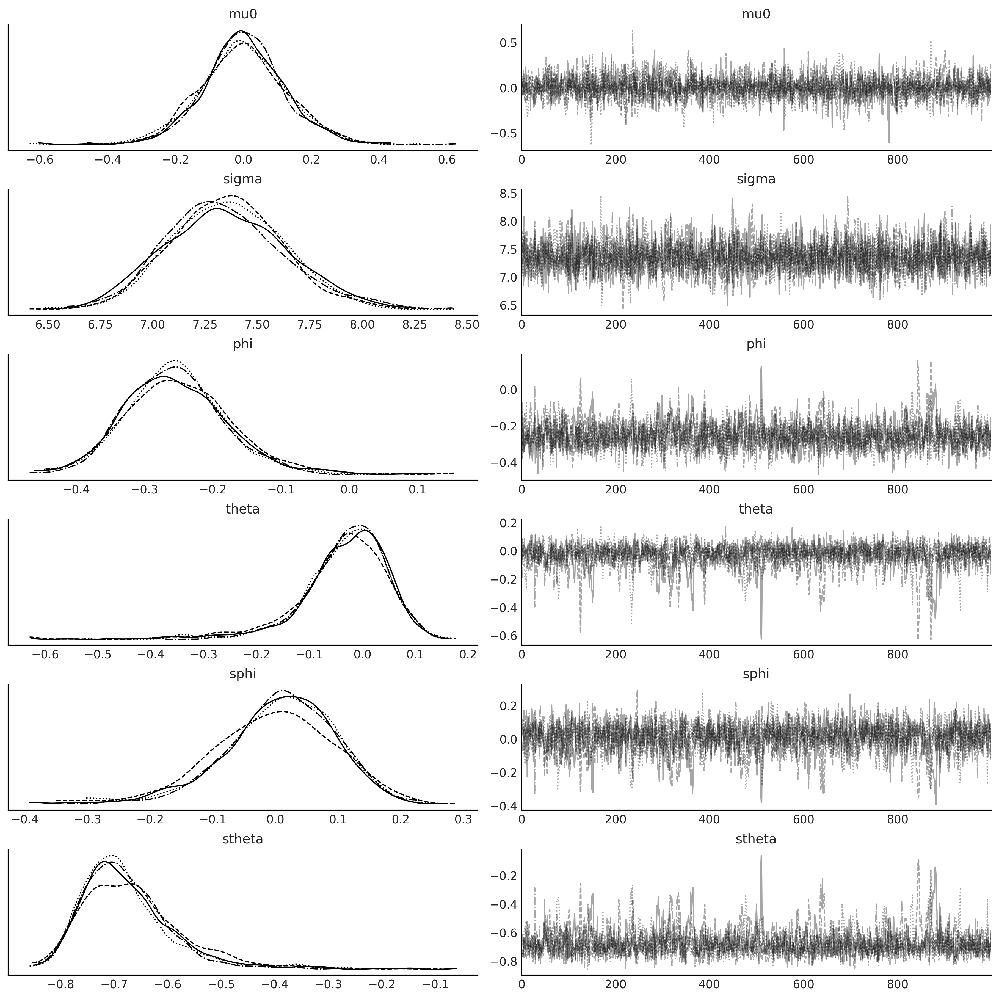

In [59]:
nuts_trace_arima = az.from_dict(
    posterior={
        k:np.swapaxes(v.numpy(), 1, 0)
        for k, v in mcmc_samples._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]}
)

axes = az.plot_trace(nuts_trace_arima);

### SARIMAX Class

In [60]:
import warnings
from statsmodels.tsa.statespace.tools import diff as tsa_diff
from tensorflow_probability.python.internal import distribution_util
from tensorflow_probability.python.internal import prefer_static as ps


class SARIMAX:
    # Similar to https://www.statsmodels.org/stable/generated/statsmodels.tsa.statespace.sarimax.SARIMAX.html
    # with simple differencing
    def __init__(self,
                 observed,
                 design_matrix=None,
                 order=(1, 0, 0),
                 seasonal_order=(0, 0, 0, 0),
                 dtype=np.float32
                 ):
        """
        SARIMAX Likelihood for univariate time series
        
        order - (p,d,q)
        seasonal_order - (P,D,Q,s)
        """
        # Static parameters
        self.p, self.d, self.q = order
        self.P, self.D, self.Q, self.period = seasonal_order

        # Dynamic regression
        if design_matrix is not None:
            assert ps.rank(design_matrix) >= 2
            assert ps.shape(design_matrix)[-2] == observed.shape[-1]

            # seasonal adjustment
            if self.period > 0:
                warnings.warn("""
                Can not model seasonal difference with Dynamic regressions,
                Setting D to 0 ...
                """)
                self.period = 0

            self.design_matrix = tf.convert_to_tensor(
                np.diff(design_matrix, n=self.d, axis=0), dtype=dtype)
        else:
            self.design_matrix = None

        if self.period <= 1:
            self.P, self.D, self.Q = 0, 0, 0

        self.r = max(self.p, self.q, self.P *
                     self.period, self.Q * self.period)

        # Simple differencing
        observed_diff = tsa_diff(
            observed,
            k_diff=self.d,
            k_seasonal_diff=self.D,
            seasonal_periods=self.period)
        self.observed = tf.convert_to_tensor(observed_diff, dtype=dtype)

        self.dtype = dtype

    def _log_prob(self, *args):
        mu0 = args[0]  # Location parameter
        sigma = args[1]  # Scale parameter
        i = 2
        if self.design_matrix is not None:  # regression coefficients
            reg_coeff = args[i]
            mu_t = mu0[None, ...] + \
                tf.einsum('...i,ji->j...', reg_coeff, self.design_matrix)
            i += 1
        else:
            mu_t = tf.einsum('...,j->j...', mu0, ps.ones_like(self.observed))

        # Parse args and prepare states
        if self.p > 0:  # AR coefficients
            phi = args[i]
            i += 1
        if self.q > 0:  # MA coefficients
            theta = args[i]
            i += 1
        if self.P > 0:  # SAR coefficients
            sphi = args[i]
            i += 1
        if self.Q > 0:  # SMA coefficients
            stheta = args[i]
            i += 1

        batch_shape = ps.shape(mu0)
        y_extended = ps.concat(
            [ps.zeros(tf.concat([[self.r], batch_shape], axis=0), dtype=mu0.dtype),
             tf.einsum('...,j->j...',
                       ps.ones_like(mu0, dtype=self.observed.dtype),
                       self.observed)],
            axis=0
        )
        eps_t = ps.zeros_like(y_extended, dtype=self.observed.dtype)

        def body_fn(t, mu_t, eps_t):
            mu_temp = []
            t_switch = t + self.r
            if self.p > 0:  # AR
                y_past = tf.gather(
                    y_extended, t_switch - (np.arange(self.p) + 1))
                ar = tf.einsum("...p,p...->...", phi, y_past)
                mu_temp.append(ar)
            if self.q > 0:  # MA
                eps_past = tf.gather(
                    eps_t, t_switch - (np.arange(self.q) + 1))
                ma = tf.einsum("...q,q...->...", theta, eps_past)
                mu_temp.append(ma)
            if self.P > 0:  # SAR
                y_past = tf.gather(
                    y_extended, t_switch - (np.arange(self.P) + 1) * self.period)
                sar = tf.einsum("...p,p...->...", sphi, y_past)
                mu_temp.append(sar)
            if self.Q > 0:  # SMA
                eps_past = tf.gather(
                    eps_t, t_switch - (np.arange(self.Q) + 1) * self.period)
                sma = tf.einsum("...q,q...->...", stheta, eps_past)
                mu_temp.append(sma)
            mu_update = sum(mu_temp) + tf.gather(mu_t, t)
            mu_t_next = tf.tensor_scatter_nd_update(
                mu_t, [[t]], mu_update[None, ...])

            eps_update = tf.gather(y_extended, t_switch) - mu_update
            epsilon_t_next = tf.tensor_scatter_nd_update(
                eps_t, [[t_switch]], eps_update[None, ...])
            return t+1, mu_t_next, epsilon_t_next

        t, mu_output, eps_output_ = tf.while_loop(
            lambda t, *_: t < self.observed.shape[-1],
            body_fn,
            loop_vars=(0, mu_t, eps_t),
            maximum_iterations=self.observed.shape[-1])
        eps_output = eps_output_[self.r:]
        return tfd.Normal(0, sigma[None, ...]).log_prob(eps_output), mu_output
    
    def log_prob(self, *args):
        log_prob_val, _ = self._log_prob(*args)
        return ps.reduce_sum(log_prob_val, axis=0)
    
    def log_prob_elementwise(self, *args):
        sigma = args[1]  # Scale parameter
        _, mu_output = self._log_prob(*args)
        mu = distribution_util.move_dimension(mu_output, 0, -1)
        return tfd.Normal(mu, sigma[..., None]).log_prob(self.observed)

#### y ~ Sarima(1,1,1)(1,1,1)[12]

In [61]:
p, q, P, Q = 1, 1, 1, 1

@tfd.JointDistributionCoroutine
def sarima_priors():
    mu0 = yield root(tfd.StudentT(df=6, loc=0, scale=2.5, name='mu0'))
    sigma = yield root(tfd.HalfStudentT(df=7, loc=0, scale=1., name='sigma'))

    phi = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), p, name='phi'))
    theta = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), q, name='theta'))
    sphi = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), P, name='sphi'))
    stheta = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), Q, name='stheta'))


sarima_1 = SARIMAX(
    us_monthly_birth["birth_in_thousands"],
    order=(1, 1, 1),
    seasonal_order=(1, 1, 1, 12))

In [62]:
%%time
target_log_prob_fn = lambda *x: sarima_priors.log_prob(
    *x) + sarima_1.log_prob(*x)

mcmc_samples, sampler_stats = run_mcmc_simple(
    1000, sarima_priors, n_chains=4, num_adaptation_steps=1000,
    target_log_prob_fn=target_log_prob_fn,
    seed=tf.constant([623453, 456345], dtype=tf.int32),
)

CPU times: user 34.7 s, sys: 830 ms, total: 35.5 s
Wall time: 35.2 s


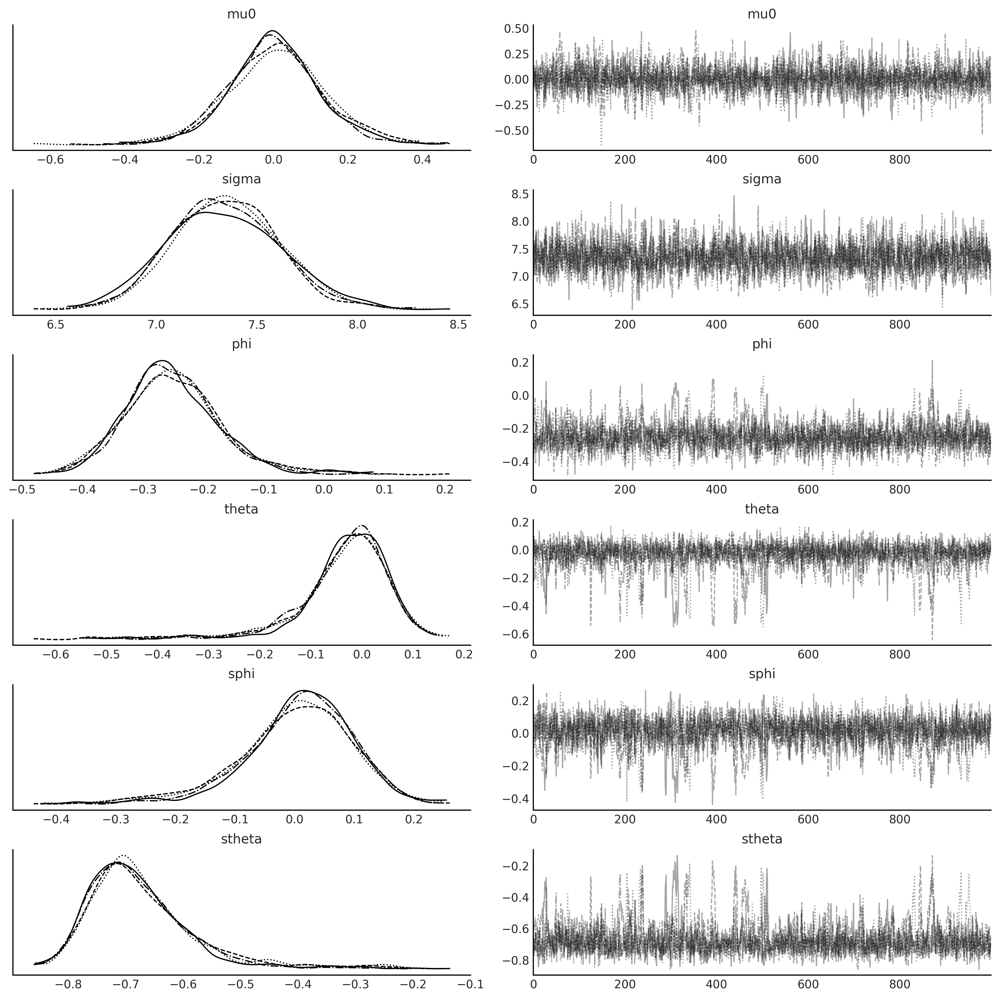

In [64]:
data_likelihood = np.swapaxes(sarima_1.log_prob_elementwise(*mcmc_samples), 1, 0)
sarima_0_idata = az.from_dict(
    posterior={
        k:np.swapaxes(v.numpy(), 1, 0)
        for k, v in mcmc_samples._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]},
    observed_data={'observed': sarima_1.observed},
    log_likelihood={'observed': data_likelihood},
)

axes = az.plot_trace(sarima_0_idata);

#### y ~ arimax(1,1,1)X[4]

In [66]:
def gen_fourier_basis(t, p=365.25, n=3):
    x = 2 * np.pi * (np.arange(n) + 1) * t[:, None] / p
    return np.concatenate((np.cos(x), np.sin(x)), axis=1)


p = 12
t_monthly = np.asarray([i % p for i in range(len(us_monthly_birth))]) + 1
monthly_X = gen_fourier_basis(t_monthly, p=p, n=2)


@tfd.JointDistributionCoroutine
def sarima_priors():
    mu0 = yield root(tfd.StudentT(df=6, loc=0, scale=2.5, name='mu0'))
    sigma = yield root(tfd.HalfStudentT(df=7, loc=0, scale=1., name='sigma'))
    beta = yield root(tfd.Sample(
        tfd.StudentT(df=6, loc=0, scale=2.5),
        monthly_X.shape[-1],
        name='beta'))
    phi = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), 1, name='phi'))
    theta = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), 1, name='theta'))


sarima_2 = SARIMAX(
    us_monthly_birth["birth_in_thousands"],
    design_matrix=monthly_X,
    order=(1, 1, 1))

In [67]:
%%time
target_log_prob_fn = lambda *x: sarima_priors.log_prob(
    *x) + sarima_2.log_prob(*x)

mcmc_samples, sampler_stats = run_mcmc_simple(
    1000, sarima_priors, n_chains=4, num_adaptation_steps=1000,
    target_log_prob_fn=target_log_prob_fn,
    seed=tf.constant([623453, 456345], dtype=tf.int32),
)

CPU times: user 39.1 s, sys: 822 ms, total: 39.9 s
Wall time: 39.6 s


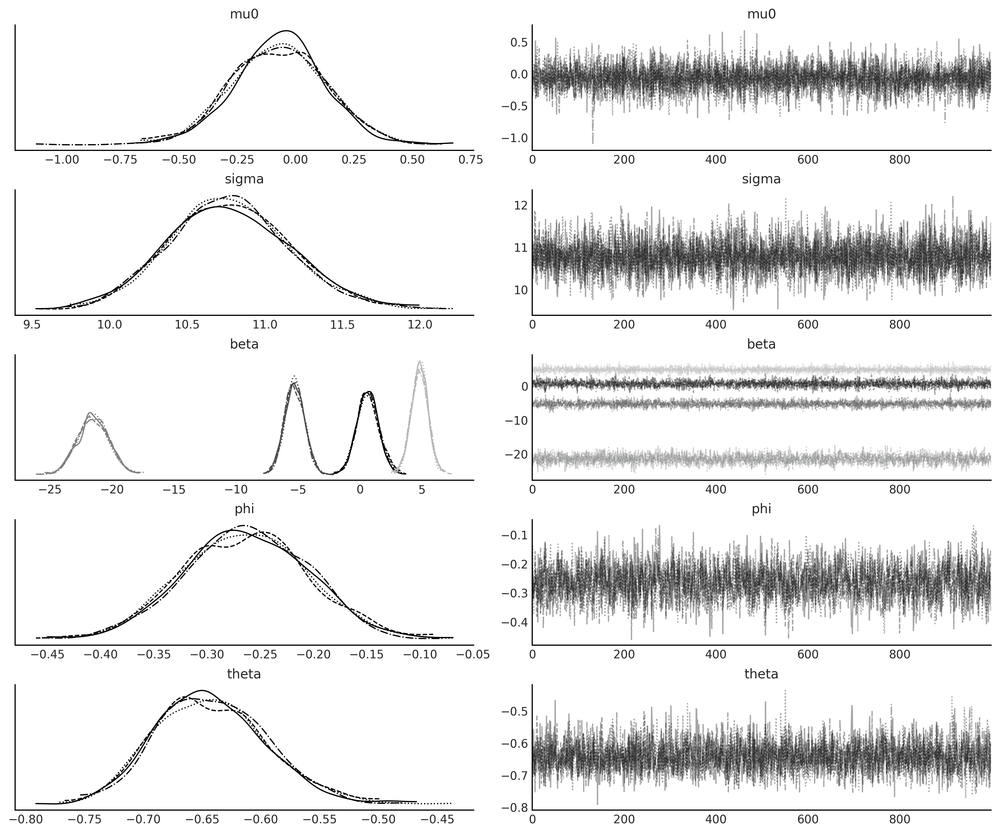

In [68]:
data_likelihood = np.swapaxes(sarima_2.log_prob_elementwise(*mcmc_samples), 1, 0)
arimax_idata = az.from_dict(
    posterior={
        k:np.swapaxes(v.numpy(), 1, 0)
        for k, v in mcmc_samples._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]},
    observed_data={'observed': sarima_2.observed},
    log_likelihood={'observed': data_likelihood},
)

axes = az.plot_trace(arimax_idata);

#### y ~ Sarima(0,1,2)(1,1,1)[12]

In [69]:
@tfd.JointDistributionCoroutine
def sarima_priors():
    mu0 = yield root(tfd.StudentT(df=6, loc=0, scale=2.5, name='mu0'))
    sigma = yield root(tfd.HalfStudentT(df=7, loc=0, scale=1., name='sigma'))

    theta = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), 2, name='theta'))
    sphi = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), 1, name='sphi'))
    stheta = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), 1, name='stheta'))

sarima_3 = SARIMAX(
    us_monthly_birth["birth_in_thousands"],
    order=(0, 1, 2),
    seasonal_order=(1, 1, 1, 12))

In [80]:
%%time
target_log_prob_fn = lambda *x: sarima_priors.log_prob(
    *x) + sarima_3.log_prob(*x)

mcmc_samples, sampler_stats = run_mcmc_simple(
    1000, sarima_priors, n_chains=4, num_adaptation_steps=1000,
    target_log_prob_fn=target_log_prob_fn,
    seed=tf.constant([934563, 12356], dtype=tf.int32),
)

CPU times: user 53.7 s, sys: 844 ms, total: 54.5 s
Wall time: 54.2 s


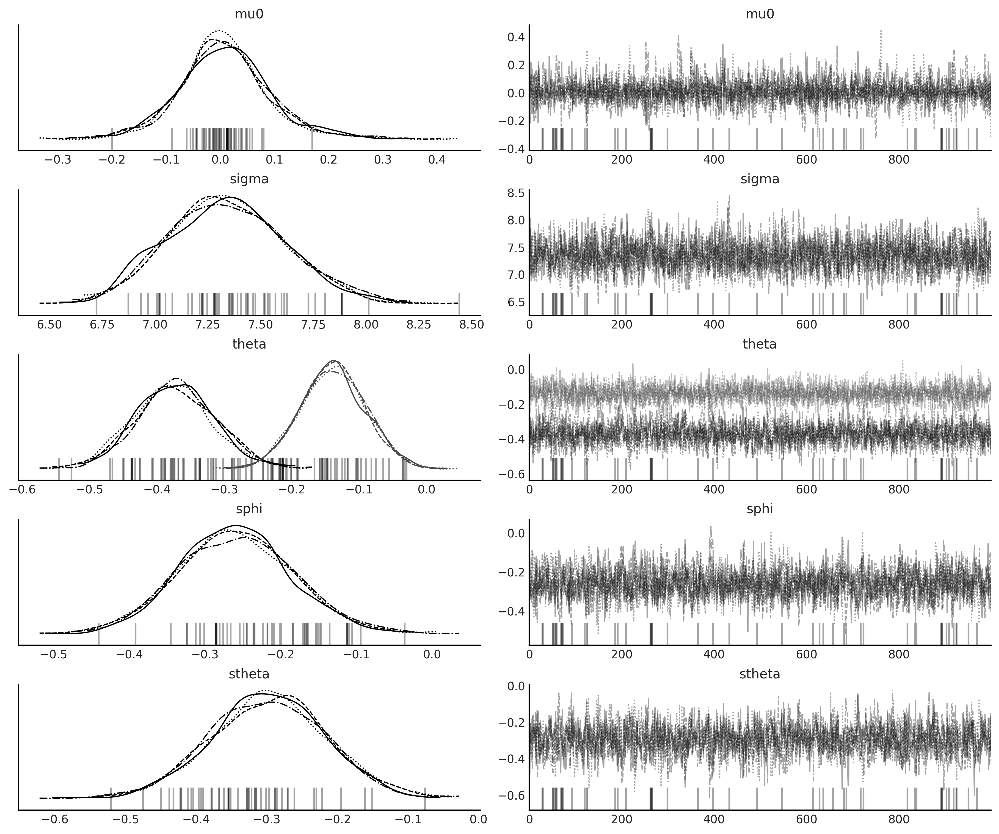

In [81]:
data_likelihood = np.swapaxes(sarima_3.log_prob_elementwise(*mcmc_samples), 1, 0)
sarima_1_idata = az.from_dict(
    posterior={
        k:np.swapaxes(v.numpy(), 1, 0)
        for k, v in mcmc_samples._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]},
    observed_data={'observed': sarima_2.observed},
    log_likelihood={'observed': data_likelihood},
)

axes = az.plot_trace(sarima_1_idata);

In [82]:
az.summary(sarima_1_idata)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu0,0.008,0.085,-0.162,0.170,0.002,0.002,3032.0,2086.0,1.0
sigma,7.343,0.277,6.857,7.884,0.005,0.004,2682.0,2494.0,1.0
theta[0],-0.373,0.059,-0.487,-0.266,0.001,0.001,2333.0,2711.0,1.0
theta[1],-0.139,0.048,-0.236,-0.055,0.001,0.001,2603.0,2698.0,1.0
sphi[0],-0.260,0.075,-0.394,-0.111,0.002,0.001,1829.0,2238.0,1.0
stheta[0],-0.297,0.083,-0.452,-0.144,0.002,0.001,1652.0,1856.0,1.0


In [83]:
compare_dict = {"SARIMA(1,1,1)(1,1,1)[12]": sarima_0_idata,
#                 "ARIMAX(1,1,1)X[4]": arimax_idata,
                "SARIMA(0,1,2)(1,1,1)[12]": sarima_1_idata}
cmp = az.compare(compare_dict, ic='loo')
cmp.round(2)

/opt/miniconda3/envs/bmcp/lib/python3.9/site-packages/arviz/stats/stats.py:145: UserWarning: The default method used to estimate the weights for each model,has changed from BB-pseudo-BMA to stacking
  warnings.warn(


,rank,loo,p_loo,d_loo,weight,se,dse,warning,loo_scale
"SARIMA(0,1,2)(1,1,1)[12]",0,-1235.67,7.58,0.00,0.5,15.43,0.0,False,log
"SARIMA(1,1,1)(1,1,1)[12]",1,-1235.98,8.28,0.32,0.5,15.50,6.3,False,log


In [75]:
# print(cmp.round(2).to_latex())

# Linear Growth Model as LGSSM

In [84]:
theta0, theta1 = 1.2, 2.6
sigma = 0.4
num_timesteps = 100

time_stamp = tf.linspace(0., 1., num_timesteps)[..., None]
yhat = theta0 + theta1 * time_stamp
y = tfd.Normal(yhat, sigma).sample()

In [85]:
# X_0
initial_state_prior = tfd.MultivariateNormalDiag(
    loc=[0., 0.], scale_diag=[5., 5.])
# F_t
transition_matrix = lambda _: tf.linalg.LinearOperatorIdentity(2)
# eta_t ~ Normal(0, Q_t)
transition_noise = lambda _: tfd.MultivariateNormalDiag(
    loc=[0., 0.], scale_diag=[0., 0.])
# H_t
H = tf.concat([tf.ones_like(time_stamp), time_stamp], axis=-1)
observation_matrix = lambda t: tf.linalg.LinearOperatorFullMatrix(
    [tf.gather(H, t)])
# epsilon_t ~ Normal(0, R_t)
observation_noise = lambda _: tfd.MultivariateNormalDiag(
    loc=[0.], scale_diag=[sigma])

linear_growth_model = tfd.LinearGaussianStateSpaceModel(
    num_timesteps=num_timesteps,
    transition_matrix=transition_matrix,
    transition_noise=transition_noise,
    observation_matrix=observation_matrix,
    observation_noise=observation_noise,
    initial_state_prior=initial_state_prior)

In [86]:
# Run the Kalman filter
(
    log_likelihoods,
    mt_filtered, Pt_filtered,
    mt_predicted, Pt_predicted,
    observation_means, observation_cov  # observation_cov is S_t
) = linear_growth_model.forward_filter(y)

/var/folders/7p/srk5qjp563l5f9mrjtp44bh800jqsw/T/ipykernel_35944/3981273553.py:31: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  plt.tight_layout();


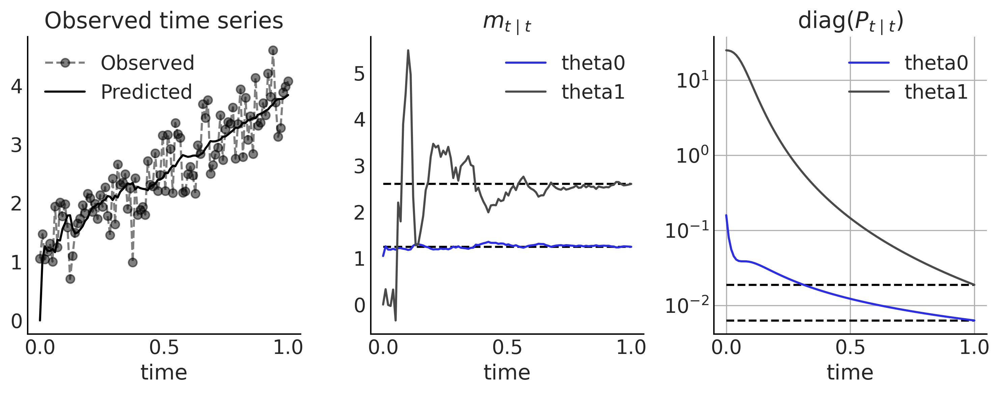

In [87]:
m0 = initial_state_prior.mean()
P0 = initial_state_prior.covariance()

P0_inv = tf.linalg.inv(P0)
P_t = tf.linalg.inv(P0_inv + 
                    1 / sigma **2 * (tf.matmul(H, H, transpose_a=True)))
m_t = tf.matmul(P_t, (1 / sigma **2 * (tf.matmul(H, y, transpose_a=True)) + 
                      tf.matmul(P0_inv, m0[..., None])))
filtered_vars = tf.linalg.diag_part(Pt_filtered)

_, ax = plt.subplots(1, 3, figsize=(10, 4))
ax[0].plot(time_stamp, y, '--o', alpha=.5);
ax[0].plot(time_stamp, observation_means, lw=1.5, color='k')
ax[0].set_title('Observed time series')
ax[0].legend(['Observed', 'Predicted'])
ax[0].set_xlabel('time');

color = ['C4', 'C1']
for i in range(2):
    ax[1].plot(time_stamp, tf.transpose(mt_filtered[..., i]), color=color[i]);
    ax[2].semilogy(time_stamp, tf.transpose(filtered_vars[..., i]), color=color[i]);
for i in range(2):
    ax[i+1].set_xlabel('time')
    ax[i+1].legend(['theta0', 'theta1'])

ax[1].hlines(m_t, time_stamp[0], time_stamp[-1], ls='--');
ax[1].set_title(r'$m_{t \mid t}$')
ax[2].hlines(tf.linalg.diag_part(P_t), time_stamp[0], time_stamp[-1], ls='--')
ax[2].set_title(r'diag($P_{t \mid t}$)')
ax[2].grid()
plt.tight_layout();

plt.savefig("img/chp06/fig16_linear_growth_lgssm.png");

## ARMA as LGSSM

In [88]:
num_timesteps = 300
phi1 = -.1
phi2 = .5
theta1 = -.25
sigma = 1.25

# X_0
initial_state_prior = tfd.MultivariateNormalDiag(
    scale_diag=[sigma, sigma])
# F_t
transition_matrix = lambda _: tf.linalg.LinearOperatorFullMatrix(
    [[phi1, 1], [phi2, 0]])
# eta_t ~ Normal(0, Q_t)
R_t = tf.constant([[sigma], [sigma*theta1]])
Q_t_tril = tf.concat([R_t, tf.zeros_like(R_t)], axis=-1)
transition_noise = lambda _: tfd.MultivariateNormalTriL(
    scale_tril=Q_t_tril)
# H_t
observation_matrix = lambda t: tf.linalg.LinearOperatorFullMatrix(
    [[1., 0.]])
# epsilon_t ~ Normal(0, 0)
observation_noise = lambda _: tfd.MultivariateNormalDiag(
    loc=[0.], scale_diag=[0.])

arma = tfd.LinearGaussianStateSpaceModel(
    num_timesteps=num_timesteps,
    transition_matrix=transition_matrix,
    transition_noise=transition_noise,
    observation_matrix=observation_matrix,
    observation_noise=observation_noise,
    initial_state_prior=initial_state_prior
    )

# Simulate from the model
sim_ts = arma.sample()

In [89]:
np.linalg.eigvals(Q_t_tril @ tf.transpose(Q_t_tril)) >= 0

array([ True,  True])

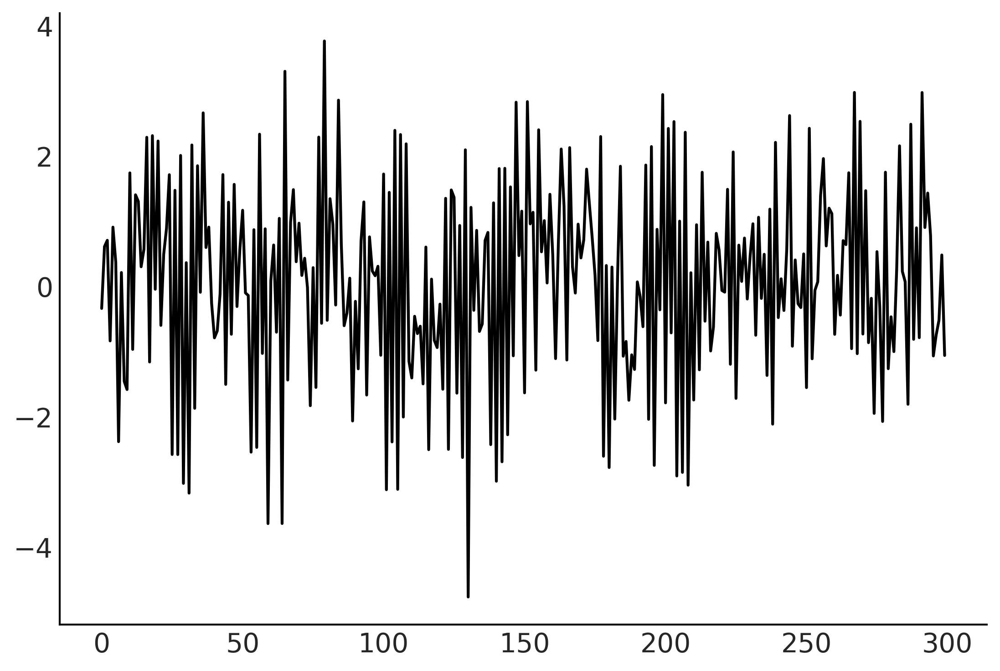

In [90]:
plt.plot(sim_ts);

In [91]:
arma.log_prob(sim_ts)

<tf.Tensor: shape=(), dtype=float32, numpy=-489.05463>

In [93]:
@tfd.JointDistributionCoroutine
def arma_lgssm():
    sigma = yield root(tfd.HalfStudentT(df=7, loc=0, scale=1., name='sigma'))
    phi = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), 2, name='phi'))
    theta = yield root(tfd.Sample(tfd.Normal(loc=0, scale=0.5), 1, name='theta'))

    # X0
    init_scale_diag = tf.concat([sigma[..., None], sigma[..., None]], axis=-1)
    initial_state_prior = tfd.MultivariateNormalDiag(
        scale_diag=init_scale_diag)

    F_t = tf.concat([phi[..., None],
                     tf.concat([tf.ones_like(phi[..., 0, None]),
                                tf.zeros_like(phi[..., 0, None])],
                               axis=-1)[..., None]],
                    axis=-1)

    def transition_matrix(_): return tf.linalg.LinearOperatorFullMatrix(F_t)

    transition_scale_tril = tf.concat(
        [sigma[..., None], theta * sigma[..., None]], axis=-1)[..., None]
    scale_tril = tf.concat(
        [transition_scale_tril,
         tf.zeros_like(transition_scale_tril)],
        axis=-1)

    def transition_noise(_): return tfd.MultivariateNormalTriL(
        scale_tril=scale_tril)

    def observation_matrix(
        t): return tf.linalg.LinearOperatorFullMatrix([[1., 0.]])

    def observation_noise(t): return tfd.MultivariateNormalDiag(
        loc=[0], scale_diag=[0.])

    arma = yield tfd.LinearGaussianStateSpaceModel(
        num_timesteps=num_timesteps,
        transition_matrix=transition_matrix,
        transition_noise=transition_noise,
        observation_matrix=observation_matrix,
        observation_noise=observation_noise,
        initial_state_prior=initial_state_prior,
        name='arma')

In [100]:
%%time
mcmc_samples, sampler_stats = run_mcmc_simple(
    1000, arma_lgssm, n_chains=4, num_adaptation_steps=1000,
    seed=tf.constant([23453, 94567], dtype=tf.int32),
    arma=sim_ts)

CPU times: user 5min 40s, sys: 1.27 s, total: 5min 42s
Wall time: 5min 42s


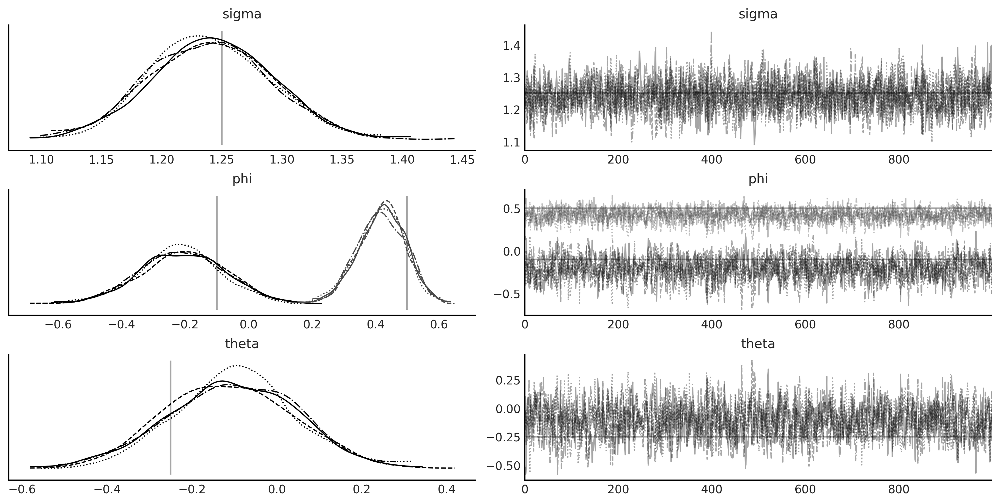

In [101]:
test_trace = az.from_dict(
    posterior={
        k:np.swapaxes(v.numpy(), 1, 0)
        for k, v in mcmc_samples._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]}
)

lines = (('sigma', {}, sigma), ('phi', {}, [phi1, phi2]), ('theta', {}, theta1),)
axes = az.plot_trace(test_trace, lines=lines);

plt.savefig("img/chp06/fig17_arma_lgssm_inference_result.png");

# Bayesian Structural Time Series Models on Monthly live birth Data

In [112]:
def generate_bsts_model(observed=None):
    """
    Args:
    observed: Observed time series, tfp.sts use it to generate data informed prior.
    """
    # Trend
    trend = tfp.sts.LocalLinearTrend(observed_time_series=observed)
    # Seasonal
    seasonal = tfp.sts.Seasonal(num_seasons=12, observed_time_series=observed)
    # Full model
    return tfp.sts.Sum([trend, seasonal], observed_time_series=observed)

observed = tf.constant(us_monthly_birth["birth_in_thousands"], dtype=tf.float32)
birth_model = generate_bsts_model(observed=observed)

# Generate the posterior distribution conditioned on the observed
# target_log_prob_fn = birth_model.joint_log_prob(observed_time_series=observed)

birth_model_jd = birth_model.joint_distribution(observed_time_series=observed)

In [103]:
birth_model.components

In [104]:
birth_model.components[1].parameters

[Parameter(name='drift_scale', prior=<tfp.distributions.LogNormal 'Seasonal_LogNormal' batch_shape=[] event_shape=[] dtype=float32>, bijector=<tfp.bijectors.Chain 'Seasonal_chain_of_Seasonal_scale_of_Seasonal_softplus' batch_shape=[] forward_min_event_ndims=0 inverse_min_event_ndims=0 dtype_x=float32 dtype_y=float32 bijectors=[<tfp.bijectors.Scale 'Seasonal_scale' batch_shape=[] forward_min_event_ndims=0 inverse_min_event_ndims=0 dtype_x=float32 dtype_y=float32>, <tfp.bijectors.Softplus 'Seasonal_softplus' batch_shape=[] forward_min_event_ndims=0 inverse_min_event_ndims=0 dtype_x=? dtype_y=?>]>)]

In [113]:
%%time
mcmc_samples, sampler_stats = run_mcmc(
    1000, birth_model_jd, n_chains=4, num_adaptation_steps=1000,
    seed=tf.constant([745678, 2357684], dtype=tf.int32))

2021-09-17 13:46:50.976658: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator mcmc_retry_init/assert_equal_1/Assert/AssertGuard/Assert


CPU times: user 12min 24s, sys: 6.42 s, total: 12min 31s
Wall time: 12min 23s


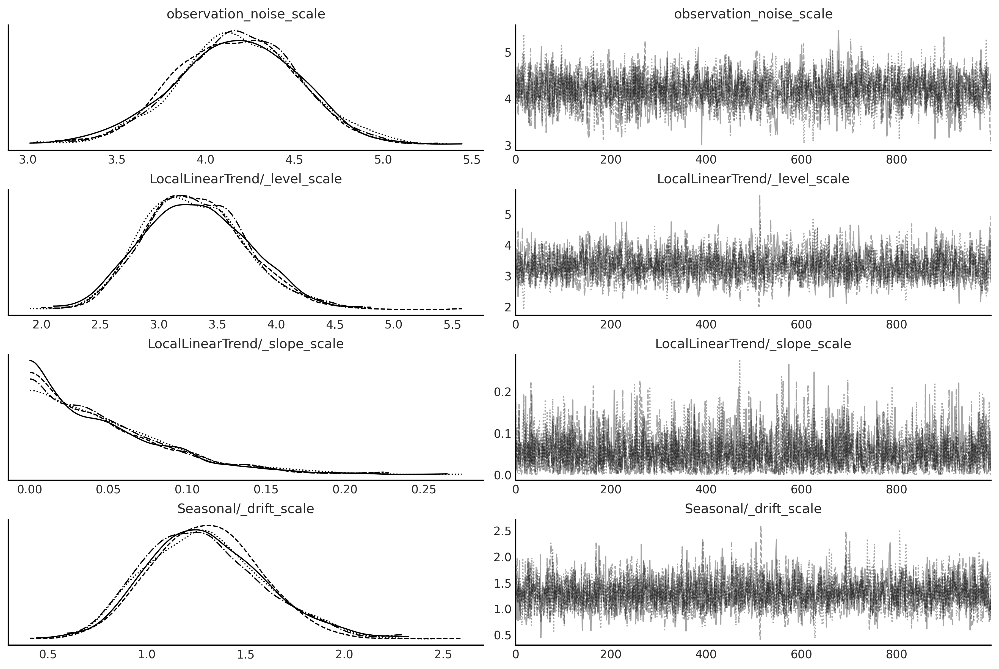

In [115]:
birth_model_idata = az.from_dict(
    posterior={
        k:np.swapaxes(v.numpy(), 1, 0)
        for k, v in mcmc_samples.items()},
    sample_stats={
        k:np.swapaxes(sampler_stats[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]}
)

axes = az.plot_trace(birth_model_idata);

In [118]:
# Using a subset of posterior samples.
parameter_samples = tf.nest.map_structure(lambda x: x[-100:, 0, ...], mcmc_samples)

# Get structual compoenent.
component_dists = tfp.sts.decompose_by_component(
    birth_model,
    observed_time_series=observed,
    parameter_samples=parameter_samples)

# Get forecast for n_steps.
n_steps = 36
forecast_dist = tfp.sts.forecast(
    birth_model,
    observed_time_series=observed,
    parameter_samples=parameter_samples,
    num_steps_forecast=n_steps)

/var/folders/7p/srk5qjp563l5f9mrjtp44bh800jqsw/T/ipykernel_35944/2909654341.py:43: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.autofmt_xdate()


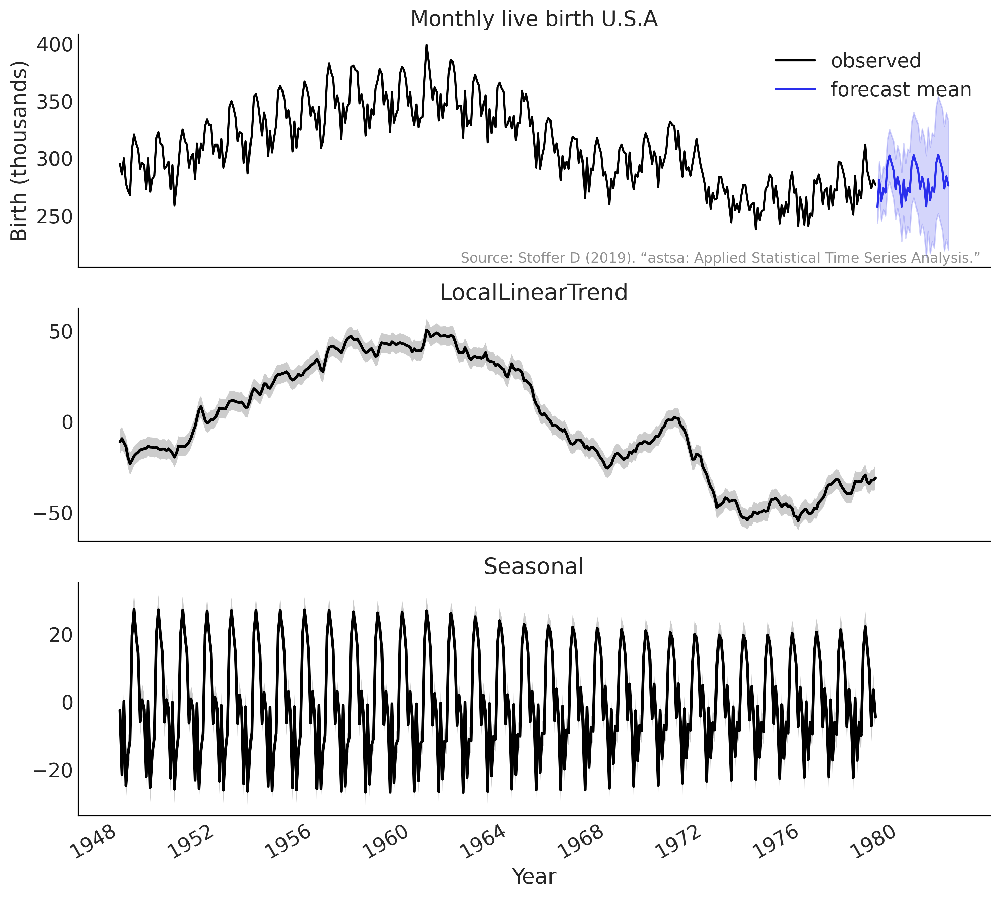

In [119]:
birth_dates = us_monthly_birth.index
forecast_date = pd.date_range(
    start=birth_dates[-1] + np.timedelta64(1, "M"),
    end=birth_dates[-1] + np.timedelta64(1 + n_steps, "M"),
    freq='M')

fig, axes = plt.subplots(
    1 + len(component_dists.keys()), 1, figsize=(10, 9), sharex=True)

ax = axes[0]
ax.plot(us_monthly_birth, lw=1.5, label='observed')

forecast_mean = np.squeeze(forecast_dist.mean())
line = ax.plot(forecast_date, forecast_mean, lw=1.5,
               label='forecast mean', color='C4')

forecast_std = np.squeeze(forecast_dist.stddev())
ax.fill_between(forecast_date,
                forecast_mean - 2 * forecast_std,
                forecast_mean + 2 * forecast_std,
                color=line[0].get_color(), alpha=0.2)

for ax_, (key, dist) in zip(axes[1:], component_dists.items()):
    comp_mean, comp_std = np.squeeze(dist.mean()), np.squeeze(dist.stddev())
    line = ax_.plot(birth_dates, dist.mean(), lw=2.)
    ax_.fill_between(birth_dates,
                     comp_mean - 2 * comp_std,
                     comp_mean + 2 * comp_std,
                     alpha=0.2)
    ax_.set_title(key.name[:-1])

ax.legend()

ax.set_ylabel("Birth (thousands)")
ax_.set_xlabel("Year")
ax.set_title("Monthly live birth U.S.A", fontsize=15)
ax.text(0.99, .02,
        "Source: Stoffer D (2019). “astsa: Applied Statistical Time Series Analysis.”",
        transform=ax.transAxes,
        horizontalalignment="right",
        alpha=0.5)

fig.autofmt_xdate()
plt.tight_layout()

plt.savefig("img/chp06/fig19_bsts_lgssm_result.png")